# Investigation of drinking water quality in NYC & infuence of traffic and recycling

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Investigation-of-drinking-water-quality-in-NYC-&amp;-infuence-of-traffic-and-recycling" data-toc-modified-id="Investigation-of-drinking-water-quality-in-NYC-&amp;-infuence-of-traffic-and-recycling-1">Investigation of drinking water quality in NYC &amp; infuence of traffic and recycling</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#0-General-introduction-and-motivation-of-the-project" data-toc-modified-id="0-General-introduction-and-motivation-of-the-project-1.0.1">0 General introduction and motivation of the project</a></span></li><li><span><a href="#1-Water-data" data-toc-modified-id="1-Water-data-1.0.2">1 Water data</a></span><ul class="toc-item"><li><span><a href="#1.1-Preprocessing" data-toc-modified-id="1.1-Preprocessing-1.0.2.1">1.1 Preprocessing</a></span></li><li><span><a href="#1.2-Basic-statistics" data-toc-modified-id="1.2-Basic-statistics-1.0.2.2">1.2 Basic statistics</a></span></li><li><span><a href="#1.3-Data-Analysis" data-toc-modified-id="1.3-Data-Analysis-1.0.2.3">1.3 Data Analysis</a></span></li><li><span><a href="#Temporal-patterns" data-toc-modified-id="Temporal-patterns-1.0.2.4">Temporal patterns</a></span></li></ul></li><li><span><a href="#2-Recycling-data" data-toc-modified-id="2-Recycling-data-1.0.3">2 Recycling data</a></span><ul class="toc-item"><li><span><a href="#Preporcessing" data-toc-modified-id="Preporcessing-1.0.3.1">Preporcessing</a></span></li><li><span><a href="#Basic-Stats" data-toc-modified-id="Basic-Stats-1.0.3.2">Basic Stats</a></span></li><li><span><a href="#Data-Analysis" data-toc-modified-id="Data-Analysis-1.0.3.3">Data Analysis</a></span></li></ul></li><li><span><a href="#3-Traffic-data" data-toc-modified-id="3-Traffic-data-1.0.4">3 Traffic data</a></span><ul class="toc-item"><li><span><a href="#Preprocessing" data-toc-modified-id="Preprocessing-1.0.4.1">Preprocessing</a></span></li><li><span><a href="#Basic-Stats---TODO" data-toc-modified-id="Basic-Stats---TODO-1.0.4.2">Basic Stats - TODO</a></span></li><li><span><a href="#Data-Analysis" data-toc-modified-id="Data-Analysis-1.0.4.3">Data Analysis</a></span></li></ul></li><li><span><a href="#4-Combined-data" data-toc-modified-id="4-Combined-data-1.0.5">4 Combined data</a></span><ul class="toc-item"><li><span><a href="#Preprocessing" data-toc-modified-id="Preprocessing-1.0.5.1">Preprocessing</a></span></li><li><span><a href="#Correlation" data-toc-modified-id="Correlation-1.0.5.2">Correlation</a></span></li></ul></li><li><span><a href="#5-Bringing-it-all-together" data-toc-modified-id="5-Bringing-it-all-together-1.0.6">5 Bringing it all together</a></span><ul class="toc-item"><li><span><a href="#5.1-Genre" data-toc-modified-id="5.1-Genre-1.0.6.1">5.1 Genre</a></span></li><li><span><a href="#5.2-Visualization" data-toc-modified-id="5.2-Visualization-1.0.6.2">5.2 Visualization</a></span></li><li><span><a href="#5.3-Discussion" data-toc-modified-id="5.3-Discussion-1.0.6.3">5.3 Discussion</a></span></li></ul></li><li><span><a href="#6-Contribution-table" data-toc-modified-id="6-Contribution-table-1.0.7">6 Contribution table</a></span></li></ul></li></ul></li></ul></div>

<a id='general'></a>
### 0 General introduction and motivation of the project

Drinking safe water is a basic human right, however there are still a lot of people without access or safe access to drinking water. Living in an industrial and developed country, this access is taken for granted but we need to be aware that it is not and that it is an important area that needs to be improved.

The United Nations have set this goal as the Sustainable Development Goal (SDG) 8, you can read more about it [here](https://sdgs.un.org/goals/goal6).

For chosing suitable data, the availability, accessibility and standardization was taken into consideration and that is why we decided to focus our investigation of drinking water on [New York City](https://opendata.cityofnewyork.us/). Also, we wanted to investigate possible influences on the drinking water quality so we decided to also analzye traffic and recycling on the streets of New York as we could imagine that more traffic and garbage could lead to decreased water quality.

Concretly, three main datasets were chosen
1. Data on the drinking water quality 
2. Data on the traffic volumne 
3. Data on the recycling 

The main goal for the end user's experience was to tell an engaging story and raise awarenwess for this topic concerning all of us. We want to take the user through our way of exploring and analyzing the data and exploring more aspects that the individual user finds interesting. 

**General code**

Below you can find the imports of the necessary libraries for the whole project

In [1]:
#!pip install geopandas
#!pip install folium matplotlib mapclassify
#!pip install pyproj
#!pip install geojson

In [2]:
import pandas as pd
from pandas.io.formats.format import Datetime64Formatter
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import seaborn as sns
import pyproj
import geojson
import geopandas as gpd
import matplotlib.pyplot as plt

from bokeh.plotting import figure
from bokeh.io import show, output_notebook, reset_output
from bokeh.models import  ColumnDataSource, Legend
from bokeh.models import HoverTool
from bokeh.layouts import layout
from bokeh.models.widgets import Tabs, Panel
from bokeh.io import curdoc
from bokeh.plotting import figure
from bokeh.models import (GMapPlot, GMapOptions, ColumnDataSource, Circle, LogColorMapper, BasicTicker, ColorBar,
    DataRange1d, PanTool, WheelZoomTool, BoxSelectTool)
from bokeh.models.mappers import ColorMapper, LinearColorMapper
from bokeh.palettes import Viridis5
from bokeh.palettes import Spectral11

import folium
from folium import plugins
from folium.plugins import HeatMap
from folium.plugins import TimeSliderChoropleth
from folium.plugins import HeatMapWithTime
from branca.element import Figure

import plotly.figure_factory as ff
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.io as pio
pio.templates.default = 'plotly_white'


%matplotlib inline


import warnings
warnings.filterwarnings("ignore")

import json
import ast
import datetime
from tqdm.notebook import tqdm

# To search for street name and convert it to coordinates
from geopy.geocoders import Nominatim
# You have to create an instance
geolocator = Nominatim(user_agent="h app")

from shapely import wkt
from shapely.geometry import Point, Polygon

output_notebook()

Loading BokehJS ...

In [4]:
from google.colab import drive
drive.mount('/content/drive')
#After executing the code above, your Drive files will be present in /content/drive/My Drive.

import sys
#sys.path.append(drive_path)

!ls '/content/drive/MyDrive/Social Data - Final project 2022/data/'

Borough Boundaries.geojson
DSNY_Monthly_Tonnage_Data.csv
Drinking_Water_Quality_Distribution_Monitoring_Data.csv
OpenData_Distribution_Water_Quality_Sampling_Sites_Updated_2021-0618.xlsx
Total_collection_of_NYC_from_2015_to_2021.csv
Water_quality.csv
Water_quality_new.csv
df_merged.csv
nybb.csv
traffic_data.csv
traffic_data_2015_2020_latlong.csv
traffic_data_2015_2020_latlong_borough.csv


In [6]:
# Google drive path
# dataset_path = '/content/drive/MyDrive/Social Data - Final project 2022/data/'
# to run locally
dataset_path = 'data/'

<a id='water'></a>
### 1 Water data

The first data for the project is data on the driking water quality from NYC open data from [here](https://data.cityofnewyork.us/Environment/Drinking-Water-Quality-Distribution-Monitoring-Dat/bkwf-xfky).

The dataset contains the following information
- Sample Number for each sample taken
- Sample Date
- Sample Time
- Sample Site  which is a code for the water sampling station
- 5 measures of the drinking water quality
    1. Residual Free Chlorine (mg/L)
    2. Turbidity (NTU)
    3. Fluoride (mg/L)
    4. Coliform (Quanti-Tray) (MPN /100mL)
    5. E.coli(Quanti-Tray) (MPN/100mL)

With the main dataset, also a meta dataset is provided from NYC on the water sampling stations containing 
- Sample Site
- Location Description of the Sample Site
- X and Y coordinate 

These two datasets are merged below to work with one main water datastet. As it was discovered that the meta dataset contained one duplicate, that was dropped before the merge. An extract is displayed to get a clearer idea of the data.

In [ ]:
# import the two datasets containing the water samples 
df_samples = pd.read_csv(dataset_path+'Drinking_Water_Quality_Distribution_Monitoring_Data.csv')
df_sites = pd.read_excel(dataset_path+'OpenData_Distribution_Water_Quality_Sampling_Sites_Updated_2021-0618.xlsx')

# drop a duplicate in the sites and merge the data together
df_sites = df_sites.drop_duplicates('Sample Site')
df_water = pd.merge(df_samples, df_sites, on='Sample Site')

# get an idea of the main dataset
df_water.head(5)

,Sample Number,Sample Date,Sample Time,Sample Site,Sample class,Residual Free Chlorine (mg/L),Turbidity (NTU),Fluoride (mg/L),Coliform (Quanti-Tray) (MPN /100mL),E.coli(Quanti-Tray) (MPN/100mL),Sample Station (SS) - Location Description,X - Coordinate,Y - Coordinate
0,201500023,01/01/2015,12:19,1S07,Operational,0.58,0.96,0.79,<1,<1,SS - Shaft 7 of City Tunnel No.1 - NE/S W 167t...,1004013,245233
1,201500083,01/02/2015,09:25,1S07,Operational,0.69,1.04,0.83,<1,<1,SS - Shaft 7 of City Tunnel No.1 - NE/S W 167t...,1004013,245233
2,201500152,01/03/2015,11:41,1S07,Operational,0.74,1.08,0.81,<1,<1,SS - Shaft 7 of City Tunnel No.1 - NE/S W 167t...,1004013,245233
3,201500211,01/04/2015,10:53,1S07,Operational,0.63,1.03,0.82,<1,<1,SS - Shaft 7 of City Tunnel No.1 - NE/S W 167t...,1004013,245233
4,201500269,01/05/2015,09:36,1S07,Operational,0.59,1.27,0.82,<1,<1,SS - Shaft 7 of City Tunnel No.1 - NE/S W 167t...,1004013,245233


<a id='preprow'></a>
#### 1.1 Preprocessing
This section is dedicated to the basic overview and cleaning of the water dataset and the following steps will be performed.

**General statistics of the dataset**
- The dataset contains 112219 samples with the 13 data columns presented above
- There are no duplicated in the samples or the sample number
- Most of the measures are in string format as well as the Time and Date
- Except for Fluoride the measures are consistently available over the samples


**The data cleaning will consist of the following steps**
1. Preprocessing of the locations to latitues and longtitudes and adding the boroughs of NYC 
2. Preprocessing of the time to extract year, month, day, hour and minute for processing the time
3. Preprocessing of the measured indicators as they are in string

In [ ]:
# check the shape
df_water.shape

(112219, 13)

In [ ]:
# check for duplicates in the data
sum(df_water.duplicated())

0

In [ ]:
# check for duplicated sample numbers
sum(df_water['Sample Number'].duplicated())

0

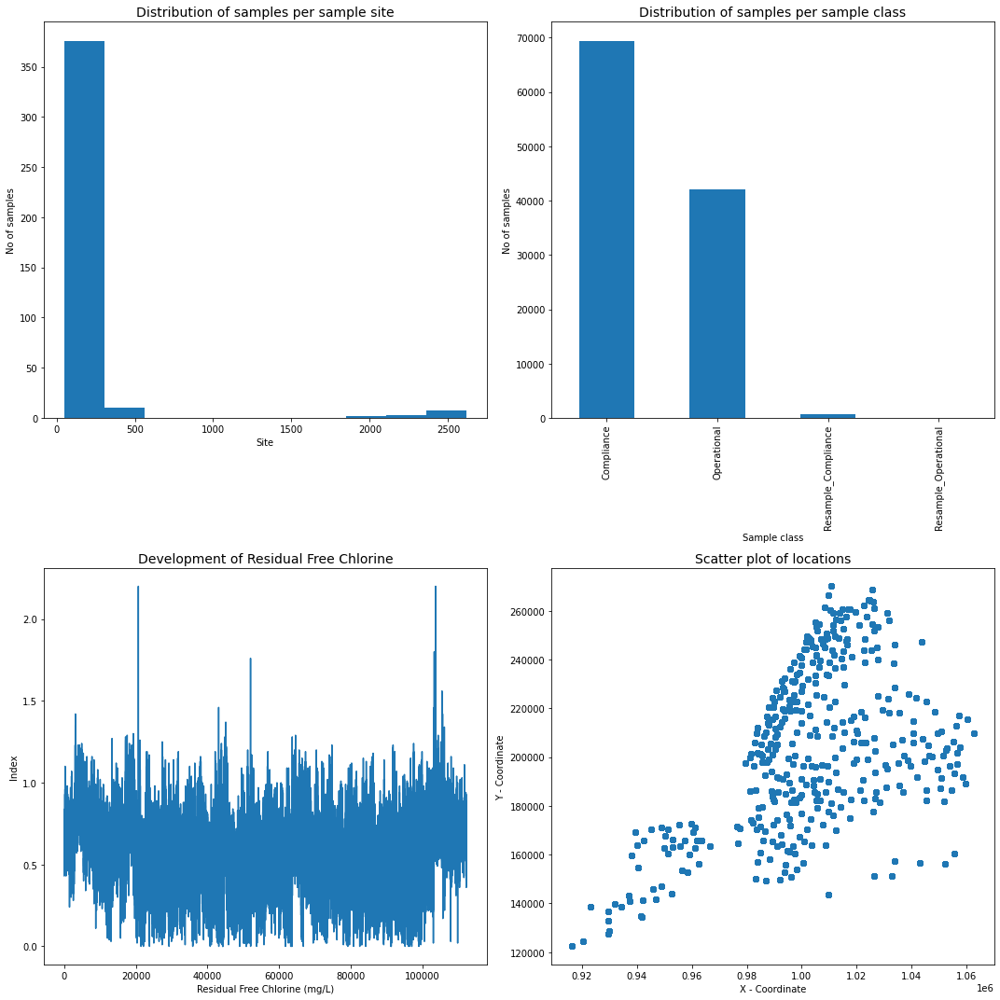

In [ ]:
# plot some distributions from the data to get first insights
plt.figure(figsize=(15,15))
plt.subplot(2,2,1)
plt.hist(df_water['Sample Site'].value_counts())
plt.title('Distribution of samples per sample site', fontsize=14)
plt.xlabel('Site')
plt.ylabel('No of samples')

plt.subplot(2,2,2)
df_water['Sample class'].value_counts().plot(kind='bar')
plt.title('Distribution of samples per sample class', fontsize=14)
plt.xlabel('Sample class')
plt.ylabel('No of samples')

plt.subplot(2,2,3)
df_water['Residual Free Chlorine (mg/L)'].plot()
plt.title('Development of Residual Free Chlorine', fontsize=14)
plt.ylabel('Residual Free Chlorine (mg/L)')
plt.xlabel('Index')

plt.subplot(2,2,4)
plt.scatter(df_water['X - Coordinate'], df_water['Y - Coordinate'])
plt.title('Scatter plot of locations', fontsize=14)
plt.xlabel('X - Coordinate')
plt.ylabel('Y - Coordinate')

plt.tight_layout()

**Findings**

From the initial overview of the dataset, it become evident that there are potentially interesting patterns in the data to discover such as the fluctuations and peaks in the Residual Free Chlorine level and you can already see the typical shape of New York Site from the distribtuion of the samples sites. However, data cleaning is necessary to transform that data in a more usable way for example the other measures or the x and y coordinates in latitudes and longtitudes.

**Preprocessing of the locations**

First the locations will be processed to lat and long and the boroughs of NYC will be added.

In [ ]:
# convert the coordinates to lat and long
# Coordinate system of the file from https://aem.run/posts/2021-07-02-learning-the-basics-of-gis-mapping-with-leaflet/
source_crs = 'epsg:2263'
target_crs = 'epsg:4326' # Global lat-lon coordinate system

polar_to_latlon = pyproj.Transformer.from_crs(source_crs, target_crs)
df_water['lat'], df_water['lon'] = polar_to_latlon.transform(df_water['X - Coordinate'], df_water['Y - Coordinate'])

df_water.drop(columns=['X - Coordinate', 'Y - Coordinate'], inplace=True)

In [ ]:
# for the exploration of the locations a subset will be used only consisting of the unique sample sites
df_loc = df_water[['Sample Site', 'lat', 'lon']]
df_loc = df_loc.drop_duplicates().reset_index()

In [ ]:
# a map was created to get an overview of the sample sites
ny_map = folium.Map(location=[ 40.730610, -73.935242], zoom_start = 10)

for index,row in df_loc.iterrows():
    pop = row['Sample Site']
    folium.CircleMarker([row['lat'], row['lon']], popup=f'Sample Site: {pop}', 
                        fill=True, opacity=0.5, radius = 2).add_to(ny_map)
ny_map

Exploring the folium map, clearly reveals a connection between the start of the name of the sample site and the borough of NYC as follows
- 1: Bronx
- 2: Brooklyn
- 3: Manhattan
- 4: Queens
- 5: Staten Island

and that is implemented below to retrieve the borough information from that data.

In [ ]:
# this pattern is implemented in the code below 
# also a color is set for each borough to check visually afterwards if the assignment of boroughs was successful
for index, row in df_water.iterrows():
    if row['Sample Site'].startswith('2'):
        df_water.at[index, 'color'] = 'yellow'
        df_water.at[index, 'borough'] = 'Brooklyn'
    elif row['Sample Site'].startswith('5'):
        df_water.at[index, 'color'] = 'purple'
        df_water.at[index, 'borough'] = 'Staten Island'
    elif row['Sample Site'].startswith('4') or row['Sample Site'].startswith('7'):
        df_water.at[index, 'color'] = 'orange'
        df_water.at[index, 'borough'] = 'Queens'
    elif row['Sample Site'].startswith('1'):
        df_water.at[index, 'color'] = 'red'
        df_water.at[index, 'borough'] = 'Bronx'
    elif row['Sample Site'].startswith('3'):
        df_water.at[index, 'color'] = 'green'
        df_water.at[index, 'borough'] = 'Manhattan'
    else: 
        df_water.at[index, 'color'] = 'blue'

In [ ]:
# plotting the map with the assigned boroughs again to check the preprocessing
df_loc = df_water[['Sample Site', 'lat', 'lon', 'color', 'borough']]
df_loc = df_loc.drop_duplicates().reset_index()

ny_map = folium.Map(location=[ 40.730610, -73.935242], zoom_start = 10)

for index,row in df_loc.iterrows():
    pop = row['Sample Site']
    bor = row['borough']
    folium.CircleMarker([row['lat'], row['lon']], popup=f'Sample Site: {pop}, Borough: {bor}', color=row['color'],
            fill=True, opacity=0.8, radius = 2).add_to(ny_map)

ny_map

**Findings**

There are various sample stations spread over the five boroughs and the naming conventions enabled an easy borough distinction and mapping as can be seen above.

**Preprocssing of time**

The time will be processed and the different time frames extracted to be able to analyze number of samples collected and the quality of these samples over different time frames to find temporal patterns.


In [ ]:
# create separate columns on the time data
df_water['Year'] = df_water['Sample Date'].str.split('/').str[2].astype('int')
df_water['Month'] = df_water['Sample Date'].str.split('/').str[0].astype('int')
df_water['Day'] = df_water['Sample Date'].str.split('/').str[1].astype('int')
df_water['Min'] = df_water['Sample Time'].str.split(':').str[1].astype('int')
df_water['Hour'] = df_water['Sample Time'].str.split(':').str[0]

In [ ]:
# the preprocessing revealed that the hour column has some unexpected values
df_water.Hour.value_counts()

09               27444
10               26250
11               21514
08               20904
12                8080
07                7005
13                 796
06                 162
14                  27
05                  11
1899-12-31T11        5
15                   4
1899-12-31T09        4
1899-12-31T08        3
1899-12-31T10        2
16                   2
04                   2
17                   1
1899-12-31T12        1
19                   1
1899-12-31T07        1
Name: Hour, dtype: int64

In [ ]:
# these rows were filtered out using their lengths
# with help from https://stackoverflow.com/questions/68399006/remove-the-row-from-dataframe-that-has-string-length-greater-than-a-certain-num
df_water = df_water[df_water.Hour.str.len().le(2)]

In [ ]:
# preprocess hour data further to int as the other columns after clean up
df_water['Hour'] = df_water['Hour'].astype('int')

In [ ]:
# add a year and month column for the overall development without going on a date level
df_water['Year - Month'] = df_water['Year'].astype('str') + "-" + df_water['Month'].astype('str')

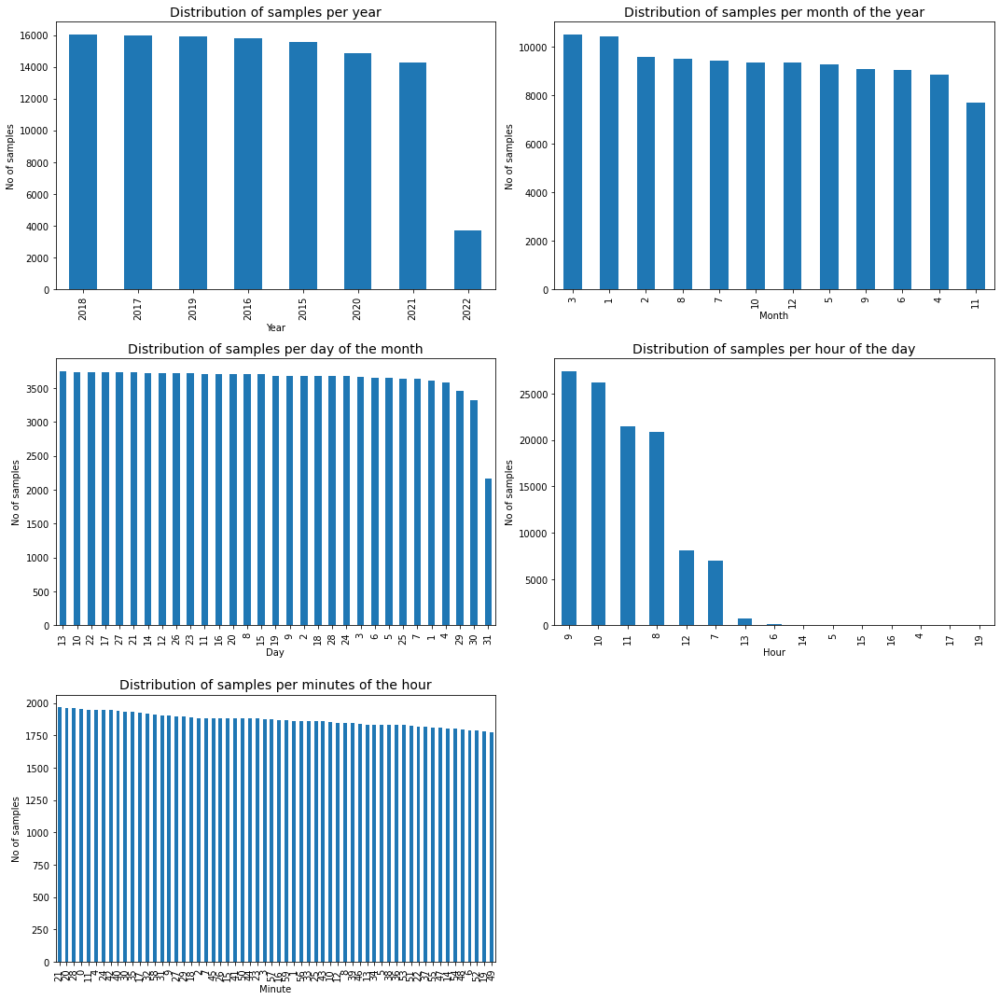

In [ ]:
# Get an overview of the times of sample collection
plt.figure(figsize=(15,15))
plt.subplot(3,2,1)
df_water['Year'].value_counts().plot(kind='bar')
plt.title('Distribution of samples per year', fontsize=14)
plt.xlabel('Year')
plt.ylabel('No of samples')

plt.subplot(3,2,2)
df_water['Month'].value_counts().plot(kind='bar')
plt.title('Distribution of samples per month of the year', fontsize=14)
plt.xlabel('Month')
plt.ylabel('No of samples')

plt.subplot(3,2,3)
df_water['Day'].value_counts().plot(kind='bar')
plt.title('Distribution of samples per day of the month', fontsize=14)
plt.xlabel('Day')
plt.ylabel('No of samples')

plt.subplot(3,2,4)
df_water['Hour'].value_counts().plot(kind='bar')
plt.title('Distribution of samples per hour of the day', fontsize=14)
plt.xlabel('Hour')
plt.ylabel('No of samples')

plt.subplot(3,2,5)
df_water['Min'].value_counts().plot(kind='bar')
plt.title('Distribution of samples per minutes of the hour', fontsize=14)
plt.xlabel('Minute')
plt.ylabel('No of samples')

plt.subplot(3,2,6)
df_water['Year - Month'].value_counts().plot(kind='bar')
plt.title('Distribution of samples per month and year', fontsize=14)
plt.xlabel('Month and Year')
plt.ylabel('No of samples')

plt.tight_layout()

**Findings** 

The visualization above shows that even though samples are collected manually, samples are consistently collected over the years, months and days. There are less samples for 2022 as the year is still going and the most current data is from March 2022 and there are less samples for the end of the month as not every month has these days such as the 31. The samples are also distributed equally over the minutes of the hour. The hour clearly shows that most samples are collected during the normal working hours in the morning between 7 and 12 but there are some outliers.

An interactive plot will be developed to explore the patterns of the data collection.

In [ ]:
# sorted Year Month
sorted_year_month = ['2015-1', '2015-2', '2015-3', '2015-4', '2015-5', '2015-6', '2015-7', '2015-8', '2015-9', '2015-10', 
          '2015-11', '2015-12', '2016-1', '2016-2', '2016-3', '2016-4', '2016-5', '2016-6', '2016-7', '2016-8', 
          '2016-9', '2016-10', '2016-11', '2016-12', '2017-1', '2017-2', '2017-3', '2017-4', '2017-5', '2017-6', 
          '2017-7', '2017-8', '2017-9', '2017-10', '2017-11', '2017-12', '2018-1', '2018-2', '2018-3','2018-4', 
          '2018-5', '2018-6', '2018-7', '2018-8', '2018-9', '2018-10', '2018-11', '2018-12', '2019-1', '2019-2', 
          '2019-3', '2019-4', '2019-5', '2019-6', '2019-7', '2019-8', '2019-9', '2019-10', '2019-11', '2019-12',
          '2020-1', '2020-2', '2020-3', '2020-4', '2020-5', '2020-6', '2020-7', '2020-8', '2020-9', '2020-10', 
          '2020-11', '2020-12', '2021-1', '2021-2', '2021-3', '2021-4','2021-5', '2021-6', '2021-7', '2021-8', 
          '2021-9','2021-10', '2021-11','2021-12', '2022-1', '2022-2', '2022-3']

In [ ]:
# Prepare year and month column

df_no_samples_month_year  = df_water.groupby('Year - Month').agg({'Sample Number':'count'}).reset_index()
df_no_samples_day = df_water.groupby('Day').agg({'Sample Number':'count'}).reset_index()
df_no_samples_month = df_water.groupby('Month').agg({'Sample Number':'count'}).reset_index()
df_no_samples_year = df_water.groupby('Year').agg({'Sample Number':'count'}).reset_index()
df_no_samples_hour = df_water.groupby('Hour').agg({'Sample Number':'count'}).reset_index()

cds_month_year = ColumnDataSource(df_no_samples_month_year)
cds_day = ColumnDataSource(df_no_samples_day)
cds_month = ColumnDataSource(df_no_samples_month)
cds_year = ColumnDataSource(df_no_samples_year)
cds_hour = ColumnDataSource(df_no_samples_hour)

list_of_bars = ['Sample Number']
colors = ['#0000FF']
dict_legend = {'Sample Number':'No of samples'}

# Create a general function for customizing legends
def customize_legend(p, items): 
    p.legend.visible = False
    legend = Legend(items=items, location="bottom_center")
    p.add_layout(legend, 'below')
    p.legend.click_policy = "mute"

# Create the general layout of the 3 plots with width, height, title and axes labels
p11 = figure(plot_width = 900, plot_height = 500,title="Number of samples taken at Month and Year", 
            x_axis_label='Year - Month', y_axis_label='Number of samples', x_range=sorted_year_month)
p22 = figure(plot_width = 900, plot_height = 500,title="Number of samples taken at Day of the month", 
            x_axis_label='Day', y_axis_label='Number of samles')
p33 = figure(plot_width = 900, plot_height = 500,title="Number of samples taken at Month of the Year", 
            x_axis_label='Month', y_axis_label='Number of samples')
p44 = figure(plot_width = 900, plot_height = 500,title="Number of samples taken in each Year 2015-2022", 
            x_axis_label='Year', y_axis_label='Number of samples')
p55 = figure(plot_width = 900, plot_height = 500,title="Number of samples taken at the Hour of the Day", 
            x_axis_label='Hour', y_axis_label='Number of samples')


# create empty dictionaries for the bars and lists for the legend items
bar11, bar22, bar33, bar44, bar55 = {}, {}, {}, {}, {}
items11, items22, items33, items44, items55 = [], [],  [], [], []

# create the bars for the three plots
for indx,i in enumerate(list_of_bars):
    bar11[i] = p11.vbar(x='Year - Month',  top=i, source=cds_month_year, legend_label=i, fill_color=colors[indx], width=0.5)
    items11.append((dict_legend[i], [bar11[i]]))
    bar22[i] = p22.vbar(x='Day',  top=i, source=cds_day, legend_label=i, fill_color=colors[indx], width=0.5) 
    items22.append((dict_legend[i], [bar22[i]]))
    bar33[i] = p33.vbar(x='Month',  top=i, source=cds_month, legend_label=i, fill_color=colors[indx], width=0.5) 
    items33.append((dict_legend[i], [bar33[i]]))
    bar44[i] = p44.vbar(x='Year',  top=i, source=cds_year, legend_label=i, fill_color=colors[indx], width=0.5) 
    items44.append((dict_legend[i], [bar44[i]]))
    bar55[i] = p55.vbar(x='Hour',  top=i, source=cds_hour, legend_label=i, fill_color=colors[indx], width=0.5) 
    items55.append((dict_legend[i], [bar55[i]]))
    
p11.xaxis.major_label_orientation = "vertical"
# customize the legend for the three plots
customize_legend(p11, items11)
customize_legend(p22, items22)
customize_legend(p33, items33)
customize_legend(p44, items44)
customize_legend(p55, items55)
    
# set the layout for the plots and add them to three tabs for the three categories
l11 = layout([[p11]])
l22 = layout([[p22]])
l33 = layout([[p33]])
l44 = layout([[p44]])
l55 = layout([[p55]])

tab11 = Panel(child=l11,title="Samples per Month and Year")
tab22 = Panel(child=l22,title="Samples per Day of Month")
tab33 = Panel(child=l33,title="Samples per Month of Year")
tab44 = Panel(child=l44,title="Samples per Year")
tab55 = Panel(child=l55,title="Samples per Hour of the Day")

tabs_all = Tabs(tabs=[tab11, tab22, tab33, tab44, tab55])
curdoc().add_root(tabs_all)

p11.add_tools(HoverTool(tooltips=[('Finding', 'The distribution over the whole timeframe looks good, but what is that \
                                    part for 2021 - 11?')]))

p22.add_tools(HoverTool(tooltips=[('Finding', 'Looks like the number of samples collected at each day of the month \
                                    is distributed equally, great! But there is a lot less samples on the  31st of the \
                                    month. Why? Just because only about every second month has a 31st so no wonder there \
                                    are less samples taken')]))

p33.add_tools(HoverTool(tooltips=[('Findings', 'Looks like the number of samples collected at each month of the year \
                                    is distributed equally, great! Only November has a smaller number of samples taken \
                                    but that is the influence of the missing November 2021')]))

p44.add_tools(HoverTool(tooltips=[('Findings', 'Looks like the number of samples collected at each year is around 15000 \
                                    for all years, great ! Only 2022 has a significant smaller amount of samples which is \
                                    because we are still in 2022')]))

p55.add_tools(HoverTool(tooltips=[('Findings', 'As the samples are collected manually it is not surprising that most of the \
                                    samples are collected during the usual workday between 7 and 12!')]))


#display plot
show(tabs_all)

**Findings**

The bokeh plot offers the possibility to add findings to the samples collection interactively and the data by time is sorted for a better understanding. This also reveals a gap in the data collection in November 2021 which might have been due to the [storms in NYC in that month](https://www.nytimes.com/2021/11/13/nyregion/tornado-storm-long-island-nyc.html) which shows the weaknesses of the data collection that one must be aware of to not come to wrong conclusions. 

**Preprocssing of measures**

To check if the measured indicators are within the allowable limits, the data needs to be available in float instead of string.
Also, an indicator will be created for the measure being within the limits (1) or above the allowable limit for drinking water (0). Finally, a global indicator called Water quality will be set up indicating sufficient water quality (1) if all measures are within the allowable limits and insufficient quality (0) if not.

The limits are as follows:
- Residual Free Chlorine [4mg/L](https://www.cdc.gov/healthywater/drinking/public/water_disinfection.html#:~:text=What%20are%20safe%20levels%20of,effects%20are%20unlikely%20to%2occur)
- Turbidity [ideally below 1 NTU](https://apps.who.int/iris/bitstream/handle/10665/254631/WHO-FWC-WSH-17.01-eng.pdf)
- Floride [4mg/L](https://www.epa.gov/sites/default/files/2015-10/documents/2011_fluoride_questionsanswers.pdf)
- Ecoli and coliform [0 MPN/100mL](https://www2.gnb.ca/content/dam/gnb/Departments/h-s/pdf/en/HealthyEnvironments/water/Coliforme.pdf)

In [ ]:
# replace the values that are not enabling a transformation to float and then save as type float
df_water['Fluoride (mg/L)'].replace({'<0.3':'0.3'}, inplace=True)
df_water['Fluoride (mg/L)'] = df_water['Fluoride (mg/L)'].astype('float')

df_water['Turbidity (NTU)'].replace({'<0.10':'0.1'}, inplace=True)
df_water['Turbidity (NTU)'] = df_water['Turbidity (NTU)'].astype('float')

df_water['Coliform_float'] = df_water['Coliform (Quanti-Tray) (MPN /100mL)'].replace({'<1':'0', '>200.5':'201'})
df_water['Coliform_float'] = df_water['Coliform_float'].astype('float')

df_water['Ecoli_float'] = df_water['E.coli(Quanti-Tray) (MPN/100mL)'].replace({'<1':'0', '>200.5':'201'})
df_water['Ecoli_float'] = df_water['Ecoli_float'].astype('float')

In [ ]:
# implement the allowable limits and the over all water quality measure
for index, row in df_water.iterrows():
    if row['Residual Free Chlorine (mg/L)']>4: 
        df_water.at[index, 'Chlorine_level'] = 0
    else:
        df_water.at[index, 'Chlorine_level'] = 1
        
for index, row in df_water.iterrows():
    if row['Turbidity (NTU)']>1: 
        df_water.at[index, 'Turbidity_level'] = 0
    else:
        df_water.at[index, 'Turbidity_level'] = 1
        
for index, row in df_water.iterrows():
    if row['Fluoride (mg/L)']>4: 
        df_water.at[index, 'Fluoride_level'] = 0
    else:
        df_water.at[index, 'Fluoride_level'] = 1

for index, row in df_water.iterrows():
    if row['Coliform_float']!=0: 
        df_water.at[index, 'Coliform_level'] = 0
    elif row['Coliform_float']==0:
        df_water.at[index, 'Coliform_level'] = 1
        
for index, row in df_water.iterrows():
    if row['Ecoli_float']!=0: 
        df_water.at[index, 'Ecoli_level'] = 0
    elif row['Ecoli_float']==0:
        df_water.at[index, 'Ecoli_level'] = 1
        
for index, row in df_water.iterrows():
    if row['Chlorine_level'] == 0 or row['Turbidity_level'] == 0 or row['Fluoride_level'] == 0 or \
    row['Coliform_level']== 0 or row['Ecoli_level'] == 0:
        df_water.at[index, 'Water_quality'] = 0
    else:
        df_water.at[index, 'Water_quality'] = 1

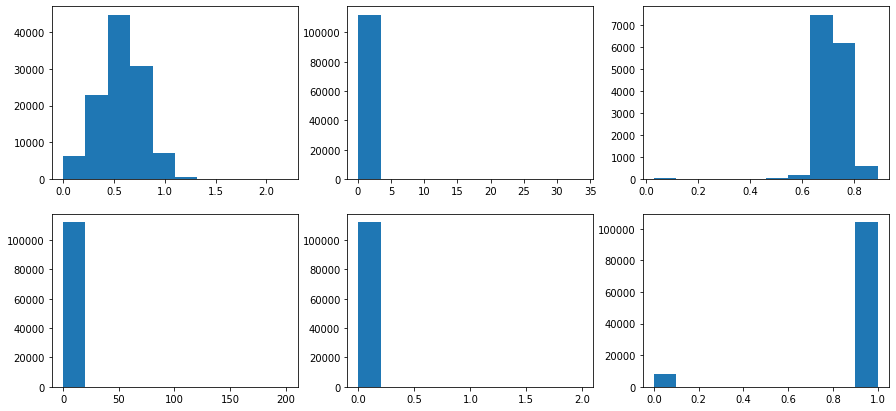

In [ ]:
# Distribution of the measures
fig, ax = plt.subplots(2, 3, figsize=(15,7))

ax[0][0].hist(df_water['Residual Free Chlorine (mg/L)'])
ax[0][1].hist(df_water['Turbidity (NTU)'])
ax[0][2].hist(df_water['Fluoride (mg/L)'])
ax[1][0].hist(df_water['Coliform_float'])
ax[1][1].hist(df_water['Ecoli_float'])
ax[1][2].hist(df_water['Water_quality'])

plt.show()

In [ ]:
plt.figure(figsize=(15,15))
plt.subplot(4,2,1)
df_water['Residual Free Chlorine (mg/L)'].plot()
plt.axhline(4, color='#FF0000')
plt.title('Development of Residual Free Chlorine', fontsize=14)
plt.ylabel('Residual Free Chlorine (mg/L)')
plt.xlabel('Index')

plt.subplot(4,2,2)
df_water['Fluoride (mg/L)'].plot()
plt.axhline(4, color='#FF0000')
plt.title('Development of Fluoride',fontsize=14)
plt.ylabel('Fluoride (mg/L)')
plt.xlabel('Index')

plt.subplot(4,2,3)
df_water['Turbidity (NTU)'].plot()
plt.axhline(1, color='#FF0000')
plt.title('Development of Turbidity', fontsize=14)
plt.ylabel('Turbidity (NTU)')
plt.xlabel('Index')

plt.subplot(4,2,4)
df_water['Ecoli_float'].plot()
plt.title('Development of Ecoli', fontsize=14)
plt.ylabel('Ecoli (MPN/100mL)')
plt.xlabel('Index')

plt.subplot(4,2,5)
df_water['Coliform_float'].plot()
plt.title('Development of Coliform', fontsize=14)
plt.ylabel('Coliform (MPN/100mL)')
plt.xlabel('Index')

plt.subplot(4,2,6)
df_water['Water_quality'].value_counts().plot(kind='bar')
plt.title('Distribution of water quality', fontsize=14)
plt.ylabel('No of samples')
plt.xlabel('Water_quality')

plt.subplot(4,2,7)
df_water['Turbidity_level'].value_counts().plot(kind='bar')
plt.title('Distribution of water quality in terms of turbidity', fontsize=14)
plt.ylabel('No of samples')
plt.xlabel('Turbidity quality')

plt.subplot(4,2,8)
df_water['Coliform_level'].value_counts().plot(kind='bar')
plt.title('Distribution of water quality in terms of coliform', fontsize=14)
plt.ylabel('No of samples')
plt.xlabel('Coliform quality')
plt.tight_layout()

**Findings**

From the measures it can be seen that the overall water quality is sufficient for most of the samples only 7.77% of all samples have insuffienct water quality.

Chlorine and Fluoride are in the allowable limits for all samples. There could be an interesting time development for Chlorine, but Fluoride is missing values for a lot of samples so will not be investigated further. Turbidity has the most measures over the limit with 7687 samples followed by Coliform with 432. Ecoli only has 12 measures that are slightly over the limit (at 2 whereas coliform measures go up to 200 MPN/100mL). 

From this first overview, turbidity seems the most interesting measure to investigate further.

What exactly is turbidity?

>>Turbidity is a measure of cloudiness of the water. Turbidity is monitored because it is a good indicator of water quality, because high turbidity can hinder the effectiveness of disinfection, and because it is a good indicator of the effectiveness of our filtration system. - [NYC Environmental Protection](https://www1.nyc.gov/assets/dep/downloads/pdf/water/drinking-water/drinking-water-supply-quality-report/2019-drinking-water-supply-quality-report.pdf)

Factors that influence turbidity are storms, high rainfall or snow melt and you can read more about it [here](https://www.tnrd.ca/services/water-sewage/chlorination-and-turbidity/).

<a id='basicw'></a>
#### 1.2 Basic statistics
- Write a short section that discusses the dataset stats, containing key points/plots from your exploratory data analysis.

In [ ]:
# save the preprocessed dataset 
df_water.to_csv(dataset_path+'Water_quality_new.csv', index=False)

<a id='daw'></a>
#### 1.3 Data Analysis

The data analysis is dedicated to investigating patterns in the indicators measured in drinking water and the overall quality of drinking water. The following aspects will be investigated
- Location based patterns
- Temporal patterns
- Measure patterns

#####  Location based patterns

In [ ]:
def grouping(indicator):
    df_group = df_water.groupby('borough').agg({indicator:['sum','count']}).reset_index()
    df_group.columns = df_group.columns.droplevel()
    df_group.rename(columns={df_group.columns[0]: "borough" }, inplace = True)
    df_group['frac_good'] = df_group['sum']/df_group['count']
    df_group['frac_all'] = df_group['sum']/len(df_water[df_water[indicator]==1])
    cds = ColumnDataSource(df_group)
    return  df_group, cds

In [ ]:
df_chlor, cds_chlor = grouping('Chlorine_level')
df_turb, cds_turb = grouping('Turbidity_level')
df_fluor, cds_fluor = grouping('Fluoride_level')
df_coli, cds_coli = grouping('Coliform_level')
df_ecoli, cds_ecoli = grouping('Ecoli_level')
df_water_qual, cds_water_qual = grouping('Water_quality')

In [ ]:
list_of_bars = ['count', 'sum']
colors = ['red', 'green']
dict_legend = {'count':'No of all samples', 'sum':'No of good samples'}

# Create a general function for customizing legends
def customize_legend(p, items): 
    p.legend.visible = False
    legend = Legend(items=items, location="top_right")
    p.add_layout(legend, 'right')
    p.legend.click_policy = "mute"

# Create the general layout of the 3 plots with width, height, title and axes labels
p1 = figure(plot_width = 950, plot_height = 500,title="Number of samples by district for water quality", 
            x_axis_label='District', y_axis_label='Number of samples in the data', x_range=df_water_qual.borough.values)
p2 = figure(plot_width = 950, plot_height = 500,title="Number of samples by district for turbidity level", 
            x_axis_label='District', y_axis_label='Number of samples in the data', x_range=df_turb.borough.values)
p3 = figure(plot_width = 950, plot_height = 500,title="Number of samples by district for chlorine level", 
            x_axis_label='District', y_axis_label='Number of samples in the data', x_range=df_chlor.borough.values)
p4 = figure(plot_width = 950, plot_height = 500,title="Number of samples by district for fluoride level", 
            x_axis_label='District', y_axis_label='Number of samples in the data', x_range=df_fluor.borough.values)
p5 = figure(plot_width = 950, plot_height = 500,title="Number of samples by district for coliform level", 
            x_axis_label='District', y_axis_label='Number of samples in the data', x_range=df_coli.borough.values)
p6 = figure(plot_width = 950, plot_height = 500,title="Number of samples by district for ecoli level", 
            x_axis_label='District', y_axis_label='Number of samples in the data', x_range=df_ecoli.borough.values)

# create empty dictionaries for the bars and lists for the legend items
bar1, bar2, bar3, bar4, bar5, bar6 = {}, {}, {}, {}, {}, {}
items1, items2, items3, items4, items5, items6 = [], [], [], [], [], []

# create the bars for the three plots
for indx,i in enumerate(list_of_bars):
    bar1[i] = p1.vbar(x='borough',  top=i, source=cds_water_qual, legend_label=i, fill_color=colors[indx], width=0.5)
    items1.append((dict_legend[i], [bar1[i]]))
    bar2[i] = p2.vbar(x='borough',  top=i, source=cds_turb, legend_label=i, fill_color=colors[indx], width=0.5) 
    items2.append((dict_legend[i], [bar2[i]]))
    bar3[i] = p3.vbar(x='borough',  top=i, source=cds_chlor, legend_label=i, fill_color=colors[indx], width=0.5) 
    items3.append((dict_legend[i], [bar3[i]]))
    bar4[i] = p4.vbar(x='borough',  top=i, source=cds_fluor, legend_label=i, fill_color=colors[indx], width=0.5)
    items4.append((dict_legend[i], [bar4[i]]))
    bar5[i] = p5.vbar(x='borough',  top=i, source=cds_coli, legend_label=i, fill_color=colors[indx], width=0.5) 
    items5.append((dict_legend[i], [bar5[i]]))
    bar6[i] = p6.vbar(x='borough',  top=i, source=cds_ecoli, legend_label=i, fill_color=colors[indx], width=0.5) 
    items6.append((dict_legend[i], [bar6[i]]))
    
# customize the legend for the three plots
customize_legend(p1, items1)
customize_legend(p2, items2)
customize_legend(p3, items3)
customize_legend(p4, items4)
customize_legend(p5, items5)
customize_legend(p6, items6)
    
# set the layout for the plots and add them to three tabs for the three categories
l1 = layout([[p1]])
l2 = layout([[p2]])
l3 = layout([[p3]])
l4 = layout([[p4]])
l5 = layout([[p5]])
l6 = layout([[p6]])
tab1 = Panel(child=l1,title="Water quality")
tab2 = Panel(child=l2,title="Turbidity level")
tab3 = Panel(child=l3,title="Chlorine level")
tab4 = Panel(child=l4,title="Fluoride level")
tab5 = Panel(child=l5,title="Coliform level")
tab6 = Panel(child=l6,title="Ecoli level")
tabs = Tabs(tabs=[tab1, tab2, tab3, tab4, tab5, tab6])
curdoc().add_root(tabs)

# add hovertool for each plot with the fraction of recommitted crimes in the group and across all groups
p1.add_tools(HoverTool(tooltips=[('Fraction of good samples for district', '@frac_good{0.0000}'),
                    ('Fraction of good samples over all district', '@frac_all{0.0000}')], renderers=[bar1['count']]))
p2.add_tools(HoverTool(tooltips=[('Fraction of good samples for district', '@frac_good{0.0000}'),
                    ('Fraction of good samples over all district', '@frac_all{0.0000}')], renderers=[bar2['count']]))
p3.add_tools(HoverTool(tooltips=[('Fraction of good samples for district', '@frac_good{0.0000}'),
                    ('Fraction of good samples over all district', '@frac_all{0.0000}')], renderers=[bar3['count']]))
p4.add_tools(HoverTool(tooltips=[('Fraction of good samples for district', '@frac_good{0.0000}'),
                    ('Fraction of good samples over all district', '@frac_all{0.0000}')], renderers=[bar4['count']]))
p5.add_tools(HoverTool(tooltips=[('Fraction of good samples for district', '@frac_good{0.0000}'),
                    ('Fraction of good samples over all district', '@frac_all{0.0000}')], renderers=[bar5['count']]))
p6.add_tools(HoverTool(tooltips=[('Fraction of good samples for district', '@frac_good{0.0000}'),
                    ('Fraction of good samples over all district', '@frac_all{0.0000}')], renderers=[bar6['count']]))

#display plot
show(tabs)

#### Temporal patterns

In [ ]:
# overall development of water quality over the time frame
fig_time = px.scatter_mapbox(df_water, lat="lat" , lon="lon", hover_name="Sample Site", color="Water_quality", 
                             opacity=0.5, animation_frame='Year - Month', mapbox_style='carto-positron', 
                             color_continuous_scale = ['#FF0000', '#0000FF'], 
                             category_orders={'Year - Month':sorted_year_month}, zoom=8)
fig_time.show()

In [ ]:
 def value_count(series):
    return series.value_counts()[0]

In [ ]:
def time_group(time, time_name):
    df_time = df_water.groupby(time).agg({'Water_quality':['count', value_count]}).reset_index()
    df_time_bor = df_water.groupby([time, 'borough']).agg({'Water_quality':['count', value_count]}).reset_index()
    df_time.columns = df_time.columns.droplevel()
    df_time.columns = [time_name, 'count', 'bad_count']
    df_time_bor.columns = df_time_bor.columns.droplevel()
    df_time_bor.columns = [time_name, 'borough', 'count', 'bad_count']
    df_time['frac_bad'] = df_time['bad_count']/df_time['count']
    df_time['frac_all'] = df_time['bad_count']/len(df_water[df_water['Water_quality']==0])
    df_time_bor['frac_bad'] = df_time_bor['bad_count']/df_time_bor['count']
    df_time_bor['frac_all'] = df_time_bor['bad_count']/len(df_water[df_water['Water_quality']==0])
    return df_time, df_time_bor

In [ ]:
df_year, df_year_bor = time_group('Year', 'Year')
boroughs = df_water.borough.unique().tolist()

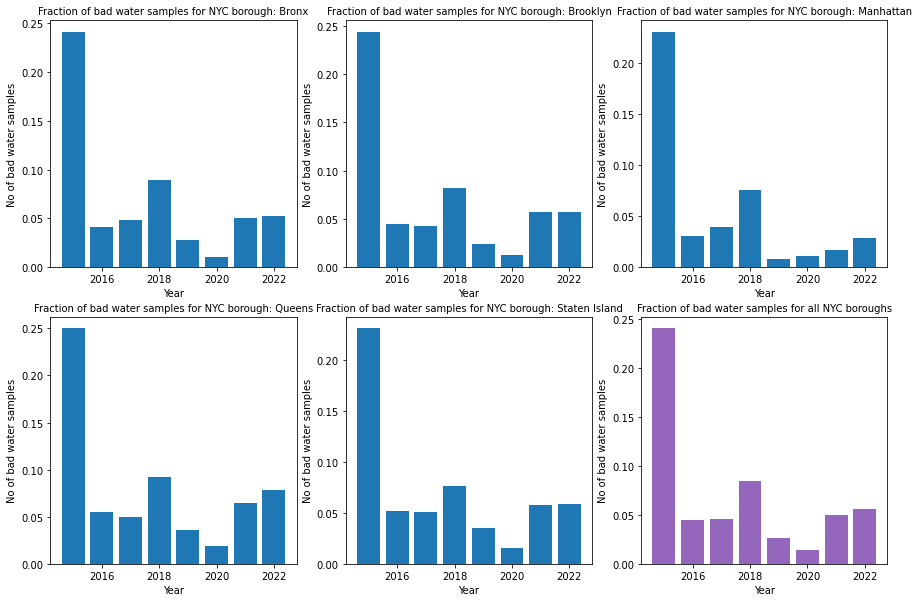

In [ ]:
plt.figure(figsize=(15,10))
for i in range(len(boroughs)):
    plot_index = i+1
    plt.subplot(2, 3, plot_index)
    
    df_filt = df_year_bor[df_year_bor.borough == boroughs[i]]
    plt.bar(df_filt['Year'], df_filt['frac_bad'])
    plt.title(f'Fraction of bad water samples for NYC borough: {boroughs[i]}', fontsize=10)
    plt.xlabel('Year')
    plt.ylabel('No of bad water samples')
    
    plt.subplot(2,3, 6)
    plt.bar(df_year['Year'], df_year['frac_bad'])
    plt.title('Fraction of bad water samples for all NYC boroughs', fontsize=10)
    plt.xlabel('Year')
    plt.ylabel('No of bad water samples')
    

plt.show()

In [ ]:
df_month, df_month_bor= time_group('Month', 'Month')

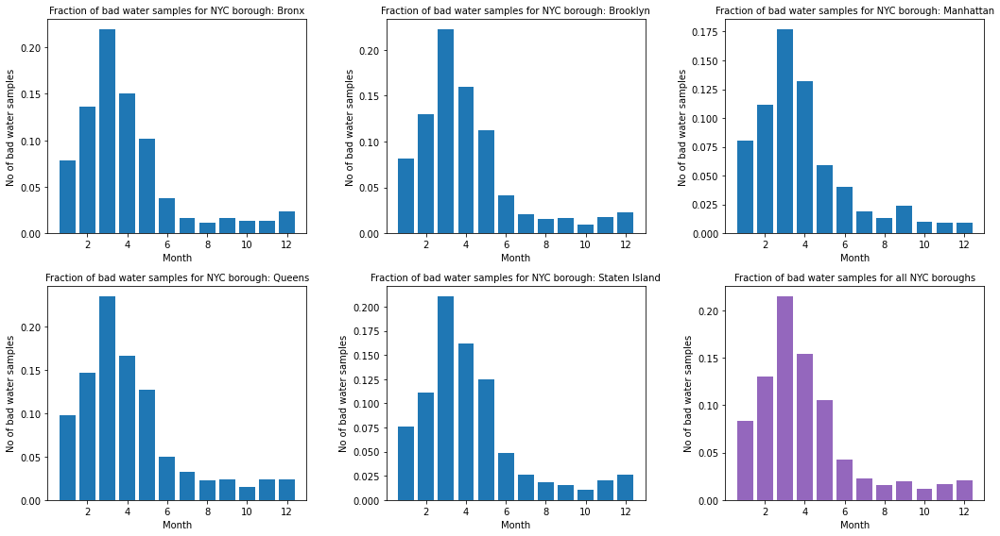

In [ ]:
plt.figure(figsize=(15,8))
for i in range(len(boroughs)):
    plot_index = i+1
    plt.subplot(2, 3, plot_index)
    
    df_filt = df_month_bor[df_month_bor.borough == boroughs[i]]
    plt.bar(df_filt['Month'], df_filt['frac_bad'])
    plt.title(f'Fraction of bad water samples for NYC borough: {boroughs[i]}', fontsize=10)
    plt.xlabel('Month')
    plt.ylabel('No of bad water samples')
    
    plt.subplot(2,3, 6)
    plt.bar(df_month['Month'], df_month['frac_bad'])
    plt.title('Fraction of bad water samples for all NYC boroughs', fontsize=10)
    plt.xlabel('Month')
    plt.ylabel('No of bad water samples')
    

plt.tight_layout()

In [ ]:
df_day, df_day_bor = time_group('Day', 'Day')

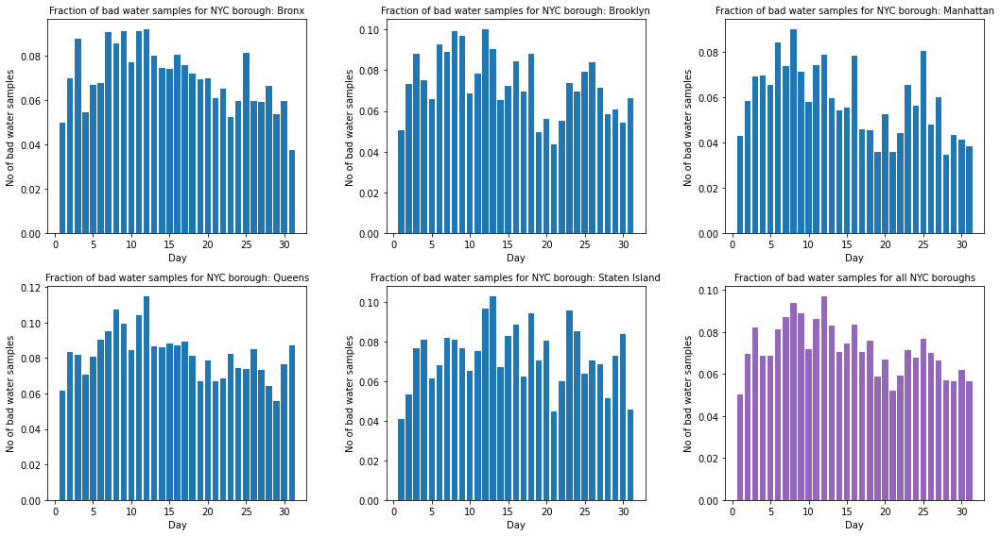

In [ ]:
plt.figure(figsize=(15,8))
for i in range(len(boroughs)):
    plot_index = i+1
    plt.subplot(2, 3, plot_index)
    
    df_filt = df_day_bor[df_day_bor.borough == boroughs[i]]
    plt.bar(df_filt['Day'], df_filt['frac_bad'])
    plt.title(f'Fraction of bad water samples for NYC borough: {boroughs[i]}', fontsize=10)
    plt.xlabel('Day')
    plt.ylabel('No of bad water samples')
    
    plt.subplot(2,3, 6)
    plt.bar(df_day['Day'], df_day['frac_bad'])
    plt.title('Fraction of bad water samples for all NYC boroughs', fontsize=10)
    plt.xlabel('Day')
    plt.ylabel('No of bad water samples')
    

plt.tight_layout()

The most interesting discovery from the Exploratory Data Analysis is that the insufficient Water quality peaks in March and as the value of the Water quality is mostly influenced by the Turbidity level that is above the limits, we discovered that turbidity is highly influenced by weather. The snow meltoff at the beginning of spring causes a lot turbidity explaining the yearly peak in march.

<a id='rec'></a>
### 2 Recycling data

The purpose of this section is to explore the basic recycling achievements of New York City and find out the correlation between reclycing and water quality.

In [ ]:
df_monthly_collection_tonnage = pd.read_csv(dataset_path+'DSNY_Monthly_Tonnage_Data.csv')

#### Preporcessing
The data cleaning will consist of the following steps
1. Preprocessing of missing values
2. Preprocessing of the time to extract month and limit the time range to a specific interval
3. Preprocessing of the measured indicators as they are in string

In [ ]:
from datetime import datetime # import datetime module
df_monthly_collection_tonnage['MONTH'] = df_monthly_collection_tonnage.MONTH.apply(lambda x:datetime.strptime(x,'%Y / %m'))
df_monthly_collection_tonnage['MONTH'] = pd.to_datetime(df_monthly_collection_tonnage['MONTH'], unit='s')
df_monthly_collection_tonnage.rename(columns={'MONTH':'DATE'},inplace=True) # modify column name

df_by_category = df_monthly_collection_tonnage[['DATE','BOROUGH','REFUSETONSCOLLECTED','PAPERTONSCOLLECTED','MGPTONSCOLLECTED','RESORGANICSTONS','SCHOOLORGANICTONS','LEAVESORGANICTONS','XMASTREETONS']]
# total amount of trash and source-seperated recycled materials collected
df_monthly_collection_tonnage['TOTALCOLLECTED'] = df_monthly_collection_tonnage.iloc[:,3:-1].sum(1)
df_monthly_collection_tonnage = df_monthly_collection_tonnage[['DATE','BOROUGH','COMMUNITYDISTRICT','BOROUGH_ID','TOTALCOLLECTED']]

Drop missing values and limit the range to time interval '2015-01-01' to '2022-01-01'

In [ ]:
df_monthly_collection_tonnage.dropna(inplace=True)
mask = ((df_monthly_collection_tonnage['DATE'] >= '2015-01-01') & (df_monthly_collection_tonnage['DATE'] < '2022-01-01')) # start date
df_monthly_collection_tonnage = df_monthly_collection_tonnage[mask]

mask2 = ((df_by_category['DATE'] >= '2015-01-01') & (df_by_category['DATE'] < '2022-01-01')) # start date
df_by_category = df_by_category[mask2]

#### Basic Stats

In this part I'll focus on exploring interesting patterns including temporal, based on the two monthly collection tonnage data and 

In [ ]:
df_monthly_collection_tonnage.shape

(4956, 5)

In [ ]:
df_by_category.shape

(4960, 9)

#### Data Analysis

In [ ]:
fig = px.bar(df_by_category.groupby('BOROUGH').mean(),text_auto=True)
fig.update_layout(title_text='NYC average collection amount(T) by category from 2015 to 2021',
         legend_title="Collection Type",)
fig.show()

**Findings**:   
1. We can see that [Staten Island](https://en.wikipedia.org/wiki/Staten_Island#Demographics) is the largest collection producer region, while interestingly it has the least population among these 5 boroughs. A fun fact is that [Fresh Kills](https://en.wikipedia.org/wiki/Fresh_Kills) of Staten Island as a "temporary landfill" in 1947,  was a repository of trash for the city of New York. By contrast, [Bronx](https://en.wikipedia.org/wiki/The_Bronx) has the least total collection and its GDP ranks the lowest among these 5 regions. 
2. The 5 boroughs had similar collection pattern. Trash or refuse is the No.1 type of collection, accounting for more than half of the total collection, following by paper usage and MGP products(recyclable metal, glass, plastic, and beverage cartons), while by contrast school organic and leave organic (materials that separated by residents before they are set out for collection) still collected very low compared to other collections.

**Temporal patterns**

In [ ]:
def plot_lines_multi(df,lw=2,pw=800,ph=500,t_str="hover,save,pan,box_zoom,reset",t_loc='above'):
    ''' Function to plot multiple lines with bokeh
    '''
    df.index = df.DATE
    df = df._get_numeric_data()
    source = ColumnDataSource(df)
    col_names = source.column_names[1:] #numeric column names

    p = figure(x_axis_type="datetime", 
            plot_width=pw, 
            plot_height=ph,
            y_range=(0,7000),
            y_axis_label='Tonnage',
            toolbar_location=t_loc, 
            tools=t_str, title="No. of different types of collection by district",)
    
    p_dict = dict() # store each collection line
    # set line color for each collection type
    numlines = len(col_names)
    mypalette=Spectral11[0:numlines]

    for col, c, col_name in zip(df.columns,mypalette,col_names):
        p_dict[col_name] = p.line(x='DATE',y=col,source=source,color=c,line_width=lw)
        p.add_tools(HoverTool(
            renderers=[p_dict[col_name]],
            tooltips=[('Date','@DATE{%F}'),('Type', f'{col_name}'),('Collection tonnage',f'@{col}')],
            formatters={'@DATE': 'datetime'}
        ))
    legend = Legend(items=[(x, [p_dict[x]]) for x in p_dict])
    p.add_layout(legend,'right')
    p.legend.click_policy = "mute"
    return p

In [ ]:
df = df_by_category.groupby(['BOROUGH','DATE']).mean().reset_index()
p1 = plot_lines_multi(df[df.BOROUGH == 'Bronx'].round())
p2 = plot_lines_multi(df[df.BOROUGH == 'Brooklyn'].round())
p3 = plot_lines_multi(df[df.BOROUGH == 'Manhattan'].round())
p4 = plot_lines_multi(df[df.BOROUGH == 'Queens'].round())
p5 = plot_lines_multi(df[df.BOROUGH == 'Staten Island'].round())

# set the layout for the plots and add them to three tabs for the three categories
tab1 = Panel(child=p1,title="Bronx")
tab2 = Panel(child=p2,title="Brooklyn")
tab3 = Panel(child=p3,title="Manhattan")
tab4 = Panel(child=p4,title="Queens")
tab5 = Panel(child=p5,title="Staten Island")
tabs = Tabs(tabs=[tab1, tab2, tab3, tab4, tab5])
curdoc().add_root(tabs)

#display plot
show(tabs)

**Findings**:   
We can see that, overally, the amount of collection of different categories increased slowly from 2015 to 2022. Staten island showed a more dramatic change between the 7 collection categories than the other boroughs.

**Preparation for geodata:**  
We can see the [index](https://furmancenter.org/files/sotc/SOC2007_IndexofCommunityDistricts_000.pdf) of each community district is given by BOROUGH_ID+COMMUNITYDISTRICT number. So we can make use of this rule to index the coordinates of these districts.

![NYC Community District](https://drive.google.com/uc?export=view&id=1K71Jhysf9V2PLpUt7m0Qoz7W0g0yGCey)

In [ ]:
# create a Borough_Community code column
df_monthly_collection_tonnage['BOR_CD'] = df_monthly_collection_tonnage[['COMMUNITYDISTRICT','BOROUGH_ID']]\
                                                 .apply(lambda x:int(x.BOROUGH_ID*100)+int(x.COMMUNITYDISTRICT),axis=1)

df_borcd_collected = df_monthly_collection_tonnage.groupby(['BOR_CD','DATE','BOROUGH'])['TOTALCOLLECTED'].mean().reset_index()

In [ ]:
def readJson(url):
    import urllib.request
    import json
    """
    Returns a json file specified in @url.
    """
    response = urllib.request.urlopen(url)
    return json.loads(response.read())


def readCSV(url):
    """
    Returns a csv file specified in @url.
    """
    response = urllib.request.urlopen(url)
    return csv.DictReader(response, delimiter=',') 

def getRegions():
    """
    Returns a dictionary formed by the id of a community district and its coordinates.
    """
    dict = {}
    # (longitude, latitude)
    url = "https://nycdatastables.s3.amazonaws.com/2013-08-19T18:22:23.125Z/community-districts-polygon.geojson"
    data = readJson(url)
    for district in data['features']:
        cd_id = district['properties']['communityDistrict'] # get the code of each community district
        dict[cd_id] = district['geometry'] # key: district code; value: geometry coordinates

    return dict

In [ ]:
url = "https://nycdatastables.s3.amazonaws.com/2013-08-19T18:22:23.125Z/community-districts-polygon.geojson"
nyc_cd_geojson = readJson(url) # NYC community district geojson
nycgeo = getRegions() # NYC community districts geo data(datatype: Polygon)

In [ ]:
from shapely.geometry import Polygon
# match geometry polygon coordinates from nyc community district geojson
parsed_data = [Polygon(item['geometry']['coordinates'][0]) for item in nyc_cd_geojson['features']]
df_borcd_collected['geometry'] = df_borcd_collected.apply(lambda x:Polygon(nycgeo[x.BOR_CD]['coordinates'][0]),axis=1)
# pandas DataFrame To GeoDataFrame
import geopandas as gpd
df = df_borcd_collected
df = gpd.GeoDataFrame(df, crs="EPSG:4326", geometry='geometry') # transform dataframe to geodataframe
df.BOR_CD = df.BOR_CD.astype('str') # so colorbar would not treat BOR_CD as 
df['date_str'] = df['DATE'].apply(lambda x: str(x)) # create a str date column

In [ ]:
collect_avg_by_cd = df.groupby(["BOROUGH",'BOR_CD']).mean().reset_index()
# match geometry polygon coordinates from nyc community district geojson
collect_avg_by_cd['geometry'] = collect_avg_by_cd.apply(lambda x:Polygon(nycgeo[int(x.BOR_CD)]['coordinates'][0]),axis=1)

**The overall recycling and trash collection tonnages between the 59 community districts.**

In [ ]:
fig = px.bar(collect_avg_by_cd.sort_values(by='TOTALCOLLECTED',ascending=False),
            x="BOR_CD", y="TOTALCOLLECTED", \
            color='TOTALCOLLECTED', \
            color_continuous_scale=px.colors.sequential.deep,
            title='NYC Average Recycled Collection Amount of 59 Community Districts, from 1992-2021', height=600)

fig.update_yaxes(title_text='Total Collected Resources(T)',ticksuffix="T") # customize y label tick

fig.show()

**Findings**:  
Community 412 is the most recycled collection origin, with around 8000T materials collected, while community 101 had the least collection, with only about 1/4 of 412's collection.

**The temporal pattern of collection tonnages in all NYC community districts.**

In [ ]:
# The df consist of monthly data of collection
# To  , each year we only select data from January
df_by_year = df[df.DATE.apply(lambda x:x.month==1)].sort_values(by='DATE') 

import plotly.express as px
figsize=(20, 10)

fig = px.choropleth_mapbox(df_by_year,
          geojson=nyc_cd_geojson, 
          locations=df_by_year.BOR_CD,
          featureidkey="properties.communityDistrict",
          center = {"lat": 40.70, "lon": -73.94},
          mapbox_style="carto-positron",
          opacity=0.5,
          color='TOTALCOLLECTED',
          hover_name="BOROUGH",
          color_continuous_scale=px.colors.sequential.deep,
          zoom=9, range_color=(0,9000),
          title='NYC Recycled Collection Amount of 59 Community Districts, from 1992-2021',
          animation_frame="date_str")
              
fig.update_geos(fitbounds="locations", visible=True)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(
    title_text='The Average Amount of NYC Recycled Collection by Community District'
)

fig.show()

When you drag the animation slide, you can see that the total trash collection amount in NYC increased overally and get a brief understanding of sanity in each community district. We can see that after 2017, the increase is obvious. Generally, there were more trash and disposals collected at community districts in Brooklyn and Queens, which are the two most populated boroughs in NYC. 

In [ ]:
df_bins = pd.read_csv('https://data.cityofnewyork.us/resource/sxx4-xhzg.csv') # read NYC trash bin data
df_bins.borough = df_bins.borough.apply(lambda x:'Brooklyn' if x=='Brooklyn ' else x) # solve abnormal column name
df_bins.dropna(inplace=True) # drop rows with missing values

In [ ]:
def boroughcolors(df):
    '''
      a function to return color name based on the value of borough in a dataframe 
    '''
    if df['borough'] == 'Bronx':
        return 'green'
    elif df['borough'] == 'Queens':
        return 'blue'
    elif df['borough'] == 'Manhattan':
        return 'black'
    elif df['borough'] == 'Brooklyn':
        return 'red'
    else:
        return 'pink'

df_bins["color"] = df_bins.apply(boroughcolors, axis=1)

In [ ]:
locations = df_bins[['latitude', 'longitude']]
locationlist = locations.values.tolist()

# customize colormap
from branca.colormap import linear
colormap = linear.YlGnBu_09.scale(min(collect_avg_by_cd['TOTALCOLLECTED']),max(collect_avg_by_cd['TOTALCOLLECTED']))
# customize map style
style_function = lambda x: {
    'fillColor': colormap(int(x['properties']['BOR_CD'])),
    'color': 'balck',
    'fillOpacity': 0.7
}
# create a map
m = folium.Map(location=[40.70, -73.94], zoom_start=10, tiles='CartoDB positron')
# plot points
for point in range(0, len(locationlist)):
    folium.Marker(locationlist[point], 
        popup=df_bins['park_site_name'].iloc[point],
        # icon address: https://lab.artlung.com/font-awesome-sample/
        icon=folium.Icon(icon='recycle', prefix='fa', color=df_bins['color'].iloc[point]),
        tooltip=df_bins['address'].iloc[point],
    ).add_to(m)

# plot polygon of borough boundaries
folium.GeoJson(
    collect_avg_by_cd,
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['TOTALCOLLECTED', 'BOROUGH', 'BOR_CD'],
        aliases=['Total collection', 'Borough', 'Community district'],
        localize=True
    )
).add_to(m)

colormap.add_to(m)
colormap.caption = 'Recycled collection amount'
colormap.add_to(m)

m

**Findings**:   
Trash bins densely and uniformly distributed at Manhatten than the other boroughs. Finding a trash bin in middle Staten Island is not as easy as North and South. This might be Staten Island is the least populated borough and in the middle there are some natural landscapes.

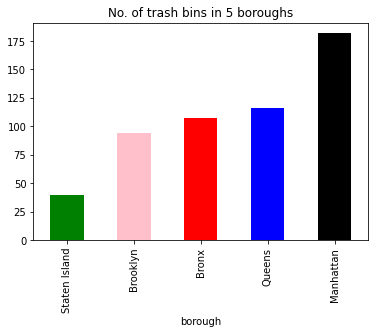

In [ ]:
df_bins.groupby('borough')['site_type'].count()\
    .sort_values().plot(kind='bar',
              title='No. of trash bins in 5 boroughs',
              color=['green','pink','red','blue','black'])

**Findings:**   
Previously, we found that Staten Island collected the most trash and disposals. Here we can see that Staten Island has the least rubbish bins, which might indicate that the trash recylcing infrastructures in Staten Island is not widespread as other boroughs so more sanity service required to collect trash. In addition, Manhattan is one of two least trash collectors. Thus, it's easier to tell Manhatten 

In [ ]:
df_merged = pd.read_csv(dataset_path+'df_merged.csv')

import geojson
with open(dataset_path+'Borough Boundaries.geojson') as f:
    gj = geojson.load(f)

In [ ]:
text=df_merged.apply(lambda row: f"<br>Total collected:{round(row['TOTALCOLLECTED'],2)}T<br>Traffic Volume:{round(row['Traffic_Volume'],2)}", axis=1),

In [ ]:
figsize=(20, 10)

fig = px.choropleth_mapbox(df_merged,
          geojson=gj, 
          locations=df_merged.borough,
          featureidkey="properties.boro_name",
          center = {"lat": 40.70, "lon": -73.94},
          mapbox_style="carto-positron",
          opacity=0.5,
          color='Residual Free Chlorine (mg/L)',
          animation_group="borough",
          hover_name="borough",
          hover_data=text,
          color_continuous_scale=px.colors.sequential.deep,
          zoom=9,
          range_color=(0,1.2),
          title='Water Quality in New York City in combination with Recycling data and Traffic data',
          animation_frame="date_str")

fig.update_layout(
    title_text='Water Quality in New York City in combination with Recycling data and Traffic data'
)

fig.show()

<a id='traffic'></a>
### 3 Traffic data

We all know that New York City has tons of traffic. 

We want to investigate whether the New York traffic has an influence on the water quality.

Specifically, we would like to investigate whether huge amounts of traffic has a negative effect on the quality of the drinking water in New York City.

While air pollution is the most visible and studied environmental consequence of transportation systems, water pollution and wetlands issues are also of crucial importance. For instance; fuel, particles, and salt-laden runoff from streets and highways result in damage to roadside soil, vegetation and trees, ponds and water supplies ([source](https://courses.washington.edu/gmforum/topics/trans_water/trans_water.htm)). The impact from the road may also contribute to other forms of water pollution, like [water turbidity](https://www.usgs.gov/special-topics/water-science-school/science/turbidity-and-water). The Environmental Protection Agency (EPA) and many States have issued regulations implementing the CWA goal of achieving and maintaining a high standard of water quality in surface and ground waters ([source](https://www.epa.gov/ny)), and [The Clean Water Act](https://www.encyclopedia.com/earth-and-environment/ecology-and-environmentalism/environmental-studies/clean-water-act-1977) gives states the responsibility to monitor and assess their waters and report the results to the EPA.

However, Water contamination often is discovered long after it has occurred. This means that the practices of today may have effects on water quality well into the future, well before we understand the full ramifications of transportation and water issues. 

In this analysis, we are particularly interested in traffic and water quality in New York City.

We there took a look at [this dataset about New York traffic](https://data.cityofnewyork.us/Transportation/Traffic-Volume-Counts-2012-2013-/p424-amsu), containing roughly 27.000 observations of traffic volume counts collected by [The New York City Department of Transportation’s (NYC DOT)](https://www1.nyc.gov/html/dot/html/about/about.shtml) for New York Metropolitan Transportation Council (NYMTC) to validate the New York Best Practice Model (NYBPM) ([source](https://www.kaggle.com/datasets/new-york-city/ny-traffic-volume-counts-2012-2013)). (**Note**: Whilst conducting this work, the dataset has been taken off the [NYC Opendata website](https://opendata.cityofnewyork.us/) and thus the work mentioned in this part (traffic) cannot be dublicated).


The dataset only contained, in the time interval '2015-02-07' to '2021-05-09':
- Date
- Street name
- Time
- Traffic volume

Thus, the core steps in the preprocessing of this data consisted of:
- Enriching the data with latitude and longitude pr "street name" (e.g. 156 Street)
- Enriching the data with what borough (that is e.g. Queens, Staten Island etc..) these street belong to

#### Preprocessing

**Important note**:

The dataset only contained, in the time interval '2015-02-07' to '2021-05-09':
- Date
- Street name
- Time
- Traffic volume

Thus, the core steps in the preprocessing of this data consisted of:
- Enriching the data with latitude and longitude pr "street name" (e.g. 156 Street)
- Enriching the data with what borough (that is e.g. Queens, Staten Island etc..) these street belong to


**Note**: Whilst conducting this work, the dataset has been taken off the [NYC Opendata website](https://opendata.cityofnewyork.us/) and thus the some mentioned in this part (traffic) cannot be dublicated.


Thus, the resulting dataset after the `non-reproducible work` is added:
- `traffic_data_2015_2020_latlong.csv`

The embedded cells (with black (in Colab) background) is non-reproducible

##### Non-reproducible work

```python
# Load NYC Traffic data
# Link: https://data.cityofnewyork.us/Transportation/Traffic-Volume-Counts-2012-2013-/p424-amsu
# LINK FORBIDDEN? 'https://data.cityofnewyork.us/api/views/ertz-hr4r/rows.csv?accessType=DOWNLOAD'
traffic_data_2014_2020 = pd.read_csv('https://data.cityofnewyork.us/api/views/ertz-hr4r/rows.csv?accessType=DOWNLOAD')
traffic_data_2014_2020.head(5)
```

```python
traffic_data_2014_2020.Date.min(), traffic_data_2014_2020.Date.max(), 
```

Since the water data, that we are also working with, only contains data from 2015 and onwards, we will restrict this dataset to the same timeframe:

```python
traffic_data_2014_2020.Date = pd.to_datetime(traffic_data_2014_2020.Date)
from_2015 = traffic_data_2014_2020[traffic_data_2014_2020.Date >= '01-01-2015']
```

Since we only have `Roadway Name` as well as `from` and `to` address, we want to enrich this data with location data (latitude & longitude). 

```python
# Preprocessing
# Lower the roadway name(s) (for bette search)
from_2015['Roadway Name'] = from_2015['Roadway Name'].apply(lambda x: x.lower())
from_2015['From'] = from_2015['From'].apply(lambda x: x.lower())
from_2015['To'] = from_2015['To'].apply(lambda x: x.lower())
```

```python 
# Define function to be able to get coordinates from street name
def get_lat_lon_from_street(street_name):
    try:
        data = geolocator.geocode(f"{street_name}, NY", timeout=None)
        lat = data.raw.get("lat")
        long = data.raw.get("lon")
    except:
        lat, long = None, None
    return lat, long
```

```python
# Get the coordinates for the "Roadway Name" column
roadway_lats = {}
for street_name in tqdm(from_2015['Roadway Name'].unique().tolist()):
    try:
        roadway_lats[f'{street_name}'] = get_lat_lon_from_street(street_name)
    except:
        roadway_lats[f'{street_name}'] = None


# Get the coordinates for the "From" column
from_lats = {}
for street_name in tqdm(from_2015.From.unique().tolist()):
    try:
        from_lats[f'{street_name}'] = get_lat_lon_from_street(street_name)
    except:
        from_lats[f'{street_name}'] = None

# Get the coordinates for the "To" column
to_lats = {}
for street_name in tqdm(from_2015.To.unique().tolist()):
    try:
        to_lats[f'{street_name}'] = get_lat_lon_from_street(street_name)
    except:
        to_lats[f'{street_name}'] = None
```

```python
# map the latitude and longitude coordinates found above to the roadway names in the dataframe
from_2015['LOCATION_ROADWAY'] = from_2015['Roadway Name'].map(roadway_lats).values
from_2015['LOCATION_FROM'] = from_2015['From'].map(from_lats).values
from_2015['LOCATION_TO'] = from_2015['To'].map(to_lats).values
```

```python
# Extracting the latitude and longitude from the coordinates mapped in the previous cell

from_2015['roadway_latitude'] = from_2015.LOCATION_ROADWAY.apply(lambda x: x[0])
from_2015['roadway_longitude'] = from_2015.LOCATION_ROADWAY.apply(lambda x: x[1])

from_2015['from_latitude'] = from_2015.LOCATION_FROM.apply(lambda x: x[0])
from_2015['from_longitude'] = from_2015.LOCATION_FROM.apply(lambda x: x[1])

from_2015['to_latitude'] = from_2015.LOCATION_TO.apply(lambda x: x[0])
from_2015['to_longitude'] = from_2015.LOCATION_TO.apply(lambda x: x[1])
```

```python
# Save results to csv
from_2015.to_csv('traffic_data_2015_2020_latlong.csv', index=False)
```

##### Reproducible work

In [7]:
df = pd.read_csv(dataset_path+'traffic_data_2015_2020_latlong.csv')
df.head(5)

,ID,Segment ID,Roadway Name,From,To,Direction,Date,12:00-1:00 AM,1:00-2:00AM,2:00-3:00AM,...,11:00-12:00AM,LOCATION_ROADWAY,LOCATION_FROM,LOCATION_TO,roadway_latitude,roadway_longitude,from_latitude,from_longitude,to_latitude,to_longitude
0,367,60160,110 avenue,155 street,156 street,EB,2016-02-27,0.0,0.0,0.0,...,79,"('41.73785325', '-74.54277005')","('40.92747425', '-73.33573757687314')","('42.6376718', '-73.7600959')",41.737853,-74.542770,40.927474,-73.335738,42.637672,-73.760096
1,367,60160,110 avenue,155 street,156 street,WB,2016-02-27,0.0,0.0,0.0,...,106,"('41.73785325', '-74.54277005')","('40.92747425', '-73.33573757687314')","('42.6376718', '-73.7600959')",41.737853,-74.542770,40.927474,-73.335738,42.637672,-73.760096
2,369,10335,amboy road,dale avenue,bishop street,NB,2016-02-27,0.0,0.0,0.0,...,133,"('40.5471126', '-74.1572327')","('40.572812', '-74.123884')","('40.573409', '-74.126811')",40.547113,-74.157233,40.572812,-74.123884,40.573409,-74.126811
3,369,10335,amboy road,dale avenue,bishop street,SB,2016-02-27,0.0,0.0,0.0,...,214,"('40.5471126', '-74.1572327')","('40.572812', '-74.123884')","('40.573409', '-74.126811')",40.547113,-74.157233,40.572812,-74.123884,40.573409,-74.126811
4,25,9001279,21 st,dead end,35 ave,NB,2019-10-09,507.0,360.0,225.0,...,694,"('40.744065', '-73.949724')","('40.8401745', '-73.82344174998985')","('40.8034816', '-73.23302')",40.744065,-73.949724,40.840175,-73.823442,40.803482,-73.233020


We're on the right path here - meaning that we now should have data on where the roads are in New York City. Let us now have a closer look at the data and what we might be able to derive from it:

In [8]:
# More preprocessing
# We wanted to see whether it being weekend had any influence on traffic observed - resulted in not being interesting
df["Is_Weekend"] =  pd.to_datetime(df["Date"]).dt.day_name().isin(['Saturday', 'Sunday'])
# Same as above, just for seasons of the year
df["Season"] =  pd.to_datetime(df["Date"]).dt.month % 12 // 3 + 1

In [9]:
# For melting these columns into one, containing (0-23) as values
traffic_hour_column_names = [
    '12:00-1:00 AM', 
    '1:00-2:00AM', 
    '2:00-3:00AM', 
    '3:00-4:00AM',
    '4:00-5:00AM', 
    '5:00-6:00AM', 
    '6:00-7:00AM', 
    '7:00-8:00AM',
    '8:00-9:00AM', 
    '9:00-10:00AM', 
    '10:00-11:00AM', 
    '11:00-12:00PM',
    '12:00-1:00PM', 
    '1:00-2:00PM', 
    '2:00-3:00PM', 
    '3:00-4:00PM',
    '4:00-5:00PM', 
    '5:00-6:00PM', 
    '6:00-7:00PM', 
    '7:00-8:00PM',
    '8:00-9:00PM', 
    '9:00-10:00PM', 
    '10:00-11:00PM', 
    '11:00-12:00AM'
]

In [10]:
# renaming traffic hours
df = df.rename(
    columns=dict(zip(traffic_hour_column_names, list(range(24))))
)

In [11]:
df.Date = pd.to_datetime(df.Date)

In [12]:
# Interesting columns (to be used in the next cell)
cols = [
    'ID', 
    'Segment ID', 
    'Roadway Name', 
    'Date',
    'roadway_latitude',
    'roadway_longitude',
    'from_latitude',
    'from_longitude',
    'to_latitude',
    'to_longitude',
    'Is_Weekend', 
    'Season'
]

In [13]:
# Melting the dataframe with respect to the columns above
df_temp_1 = df.melt(
    id_vars = cols,
    value_vars = list(range(24)),
    var_name = 'Hour',
    value_name = 'Traffic_Volume'
)

df_temp_1.head(5)

,ID,Segment ID,Roadway Name,Date,roadway_latitude,roadway_longitude,from_latitude,from_longitude,to_latitude,to_longitude,Is_Weekend,Season,Hour,Traffic_Volume
0,367,60160,110 avenue,2016-02-27,41.737853,-74.542770,40.927474,-73.335738,42.637672,-73.760096,True,1,0,0.0
1,367,60160,110 avenue,2016-02-27,41.737853,-74.542770,40.927474,-73.335738,42.637672,-73.760096,True,1,0,0.0
2,369,10335,amboy road,2016-02-27,40.547113,-74.157233,40.572812,-74.123884,40.573409,-74.126811,True,1,0,0.0
3,369,10335,amboy road,2016-02-27,40.547113,-74.157233,40.572812,-74.123884,40.573409,-74.126811,True,1,0,0.0
4,25,9001279,21 st,2019-10-09,40.744065,-73.949724,40.840175,-73.823442,40.803482,-73.233020,False,4,0,507.0


The main purpose of this is because it seems like the data-table has split the road across 2 rows in terms of direction. 

But we don't really care if the traffic in 1 side is different from the traffic on the other side heading the opposite direction. 

To us, it's the same road, so we combine the traffic on either sides together.

In [14]:
# A road is a road in our point of view - Whether the traffic is observed noth bound or south bound
df_temp_2 = df_temp_1.groupby(
    cols + ["Hour"], as_index=False
)["Traffic_Volume"].sum()

df_temp_2.head(5)

,ID,Segment ID,Roadway Name,Date,roadway_latitude,roadway_longitude,from_latitude,from_longitude,to_latitude,to_longitude,Is_Weekend,Season,Hour,Traffic_Volume
0,1,19244,kings highway,2017-10-28,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,0,194.0
1,1,19244,kings highway,2017-10-28,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,1,151.0
2,1,19244,kings highway,2017-10-28,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,2,118.0
3,1,19244,kings highway,2017-10-28,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,3,90.0
4,1,19244,kings highway,2017-10-28,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,4,90.0


In [15]:
# prepare final dataframe to work with (adding boroughs in the next step)
df_final = df_temp_2.copy()
df_final = df_final.set_index('Date')
df_final.head(5)

,ID,Segment ID,Roadway Name,roadway_latitude,roadway_longitude,from_latitude,from_longitude,to_latitude,to_longitude,Is_Weekend,Season,Hour,Traffic_Volume
Date,,,,,,,,,,,,,
2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,0,194.0
2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,1,151.0
2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,2,118.0
2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,3,90.0
2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,4,90.0


##### Adding borough

We want to be able to see similarities between the traffic and the other datasets.

To be able to do that, we have to find out which borough the specific street is in.

This is done in the following cell blocks:

In [16]:
df_polygon = gpd.read_file(dataset_path+'nybb.csv')

df_polygon['geometry'] = df_polygon['the_geom'].apply(wkt.loads)
df_polygon = gpd.GeoDataFrame(df_polygon, crs='EPSG:4326')

df_polygon.head(5)

,the_geom,BoroCode,BoroName,Shape_Leng,Shape_Area,geometry
0,MULTIPOLYGON (((-73.82644661516991 40.59052744...,4,Queens,900269.280485,3040205594.95,"MULTIPOLYGON (((-73.82645 40.59053, -73.82642 ..."
1,MULTIPOLYGON (((-73.86327471071958 40.58387684...,3,Brooklyn,728477.954082,1934167333.21,"MULTIPOLYGON (((-73.86327 40.58388, -73.86381 ..."
2,MULTIPOLYGON (((-74.05050806403247 40.56642203...,5,Staten Island,325924.002076,1623631283.36,"MULTIPOLYGON (((-74.05051 40.56642, -74.05047 ..."
3,MULTIPOLYGON (((-74.01092841268031 40.68449147...,1,Manhattan,359993.126318,636620785.519,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ..."
4,MULTIPOLYGON (((-73.89680883223778 40.79580844...,2,Bronx,463868.599917,1187193588.79,"MULTIPOLYGON (((-73.89681 40.79581, -73.89694 ..."


In [17]:
# Because each borough is a multipolygon, we cannot search for a coordinate within directly
# Thus, we exploded the multipolygons into polygons, which were then searchable
exploded = df_polygon.explode('geometry').reset_index(drop=True)
exploded.head(5)

,the_geom,BoroCode,BoroName,Shape_Leng,Shape_Area,geometry
0,MULTIPOLYGON (((-73.82644661516991 40.59052744...,4,Queens,900269.280485,3040205594.95,"POLYGON ((-73.82645 40.59053, -73.82642 40.590..."
1,MULTIPOLYGON (((-73.82644661516991 40.59052744...,4,Queens,900269.280485,3040205594.95,"POLYGON ((-73.83193 40.59345, -73.83117 40.591..."
2,MULTIPOLYGON (((-73.82644661516991 40.59052744...,4,Queens,900269.280485,3040205594.95,"POLYGON ((-73.80997 40.60007, -73.81000 40.600..."
3,MULTIPOLYGON (((-73.82644661516991 40.59052744...,4,Queens,900269.280485,3040205594.95,"POLYGON ((-73.80032 40.60706, -73.80024 40.607..."
4,MULTIPOLYGON (((-73.82644661516991 40.59052744...,4,Queens,900269.280485,3040205594.95,"POLYGON ((-73.82953 40.60724, -73.82958 40.607..."


In [18]:
# Prepare columns for found borough
df_temp = df_final.copy()
df_temp['borough_roadway'] = ''
df_temp['borough_from'] = ''
df_temp['borough_to'] = ''
df_temp = df_temp.reset_index(drop=False)

The cell below takes a long time to run (however, it works) - omitted the run in this notebook - added the resulting dataset instead

In [ ]:
# Find whether the multipolygons contains the point found above (Roadway Name)
# We initiate a dictionary to hold all association between streetnames and boroughs, 
# ...as the dataset contains 27.000 rows with many many duplicates of road names, like "1st avenue"
# This is for time saving purposes
not_found_roadway = {}
found_roadway = {}
for i in tqdm(range(len(df_temp.values))):
    # If the roadway is already found in a borough, and thus in the dictionary, assign row borough-value from dictionary
    if f'''roadway {df_temp.iloc[i]['Roadway Name']}''' in found_roadway.keys():
        try:
            df_temp.loc[i, 'borough_roadway'] = found_roadway[f'''{df_temp.iloc[i]['Roadway Name']}''']
        except:
            pass
    # If the borough is not found in the dictionary:
    # Take latitude and longitude from dataframe
    lat = df_temp.iloc[i].roadway_latitude
    long = df_temp.iloc[i].roadway_longitude
    # Try both combinations of (lat, long) / (long, lat) in case the values were put in incorrectly
    point = Point(lat, long)
    point2 = Point(long, lat)
    # Search the polygons for the coordinates
    for polygon in range(len(exploded.values)):
        if point2.within(Polygon(exploded.geometry.values[polygon])):
            # if coordinate was found in a polygon, assign borough and add to the dictionary
            df_temp.loc[i, 'borough_roadway'] = exploded.BoroName.values[polygon]
            found_roadway[f'''{df_temp.iloc[i]['Roadway Name']}'''] = exploded.BoroName.values[polygon]
            break
        else:
            df_temp.loc[i, 'borough_roadway'] = None
    # If the coordinate was not found in the polygons above, add unique (long, lat) to dictionary (if the long lat is not present)
    # If "not found" street name already was found in the dictionary, just append (long, lat) to the street name "not found"
    if df_temp.loc[i, 'borough_roadway'] == None:
        if df_temp.iloc[i]['Roadway Name'] not in not_found_roadway.keys():
            not_found_roadway[f'''{df_temp.iloc[i]['Roadway Name']}'''] = []
            not_found_roadway[f'''{df_temp.iloc[i]['Roadway Name']}'''].append((long, lat))
        else:
            if (long, lat) in not_found_roadway[f'''{df_temp.iloc[i]['Roadway Name']}''']:
                continue
            not_found_roadway[f'''{df_temp.iloc[i]['Roadway Name']}'''].append((long, lat))

The cell below takes a long time to run (however, it works) - omitted the run in this notebook - added the resulting dataset instead

In [ ]:
# Same as above, just applied to "borough_from" and "borough_to"

not_found = {}
found = {}
for i in tqdm(range(len(df_temp.values))):
    
    if (f'''from {df_temp.iloc[i]['Roadway Name']}''' in found.keys()) or (f'''to {df_temp.iloc[i]['Roadway Name']}''' in found.keys()):
        try:
            df_temp.loc[i, 'borough_from'] = found[f'''from {df_temp.iloc[i]['Roadway Name']}''']
        except:
            pass
        
        try:
            df_temp.loc[i, 'borough_to'] = found[f'''to {df_temp.iloc[i]['Roadway Name']}''']
        except:
            pass
        
        continue
    
    lat = df_temp.iloc[i].from_latitude
    long = df_temp.iloc[i].from_longitude
    point = Point(lat, long)
    point2 = Point(long, lat)
    for polygon in range(len(exploded.values)):
        if point2.within(Polygon(exploded.geometry.values[polygon])):
            df_temp.loc[i, 'borough_from'] = exploded.BoroName.values[polygon]
            found[f'''from {df_temp.iloc[i]['Roadway Name']}'''] = exploded.BoroName.values[polygon]
            break
        else:
            df_temp.loc[i, 'borough_from'] = None
    
    if df_temp.loc[i, 'borough_from'] == None:
        lat = df_temp.iloc[i].to_latitude
        long = df_temp.iloc[i].to_longitude
        point = Point(lat, long)
        point2 = Point(long, lat)
        for polygon in range(len(exploded.values)):
            if point2.within(Polygon(exploded.geometry.values[polygon])):
                df_temp.loc[i, 'borough_to'] = exploded.BoroName.values[polygon]
                found[f'''to {df_temp.iloc[i]['Roadway Name']}'''] = exploded.BoroName.values[polygon]
                break
            else:
                df_temp.loc[i, 'borough_to'] = None
            
    if (df_temp.loc[i, 'borough_from'] == None) or (df_temp.loc[i, 'borough_from'] == None):
        if df_temp.iloc[i]['Roadway Name'] not in not_found.keys():
            not_found[f'''{df_temp.iloc[i]['Roadway Name']}'''] = []
            not_found[f'''{df_temp.iloc[i]['Roadway Name']}'''].append((long, lat))
        else:
            if (long, lat) in not_found[f'''{df_temp.iloc[i]['Roadway Name']}''']:
                continue
            not_found[f'''{df_temp.iloc[i]['Roadway Name']}'''].append((long, lat))

In [ ]:
# Save results
df_temp.to_csv(dataset_path+'traffic_data_2015_2020_latlong_borough.csv', index=False)

In [19]:
# Load results from previous exercise
df = pd.read_csv(dataset_path+'traffic_data_2015_2020_latlong_borough.csv')
df.head(5)

,Date,ID,Segment ID,Roadway Name,roadway_latitude,roadway_longitude,from_latitude,from_longitude,to_latitude,to_longitude,Is_Weekend,Season,Hour,Traffic_Volume,borough_roadway,borough_from,borough_to
0,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,0,194.0,Brooklyn,Manhattan,NaN
1,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,1,151.0,Brooklyn,Manhattan,NaN
2,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,2,118.0,Brooklyn,Manhattan,NaN
3,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,3,90.0,Brooklyn,Manhattan,NaN
4,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,True,4,4,90.0,Brooklyn,Manhattan,NaN


In [20]:
# Infer Roadway Name Borough from 'borough_from' when no value is present in borough_roadway but present in borough_from
df.loc[(df['borough_roadway'].isna()) & (df['borough_from'].notna()), 'borough_roadway'] \
    = df.loc[(df['borough_roadway'].isna()) & (df['borough_from'].notna()), 'borough_from']

In [21]:
# Infer Roadway Name Borough from 'borough_to' when no value is present in borough_roadway but present in borough_to
df.loc[(df['borough_roadway'].isna()) & (df['borough_to'].notna()), 'borough_roadway'] \
    = df.loc[(df['borough_roadway'].isna()) & (df['borough_to'].notna()), 'borough_to']

In [22]:
# Look at how many rows are nan (we can't use those)
df.loc[(df['borough_roadway'].isna())].shape

(14184, 17)

In [23]:
# Take rows that are not nan for visualisations
df_res = df.loc[~(df['borough_roadway'].isna())]
df_res.Date = pd.to_datetime(df_res.Date)
df_res['year'] = df_res.Date.dt.year
df_res['month'] = df_res.Date.dt.month
df_res['weekday'] = df_res.Date.dt.weekday
df_res['day_of_month'] = df_res.Date.dt.day

In [24]:
# Save the resulting dataframe
df_res.to_csv(dataset_path+'traffic_data.csv', index=False)

<a id='basict'></a>
#### Basic Stats - TODO

In [25]:
# Load results from previous exercise
df = pd.read_csv(dataset_path+'traffic_data.csv')
df = df.rename(columns={'borough_roadway':'BOROUGH', 'Date':'DATE'})
# Align formatting of date columns and take non-null values
df = df.loc[~(df['BOROUGH'].isna())]
df.DATE = pd.to_datetime(df.DATE)
df['year'] = df.DATE.dt.year
df['month'] = df.DATE.dt.month
df['weekday'] = df.DATE.dt.weekday
df['day_of_month'] = df.DATE.dt.day
df.head(5)

,DATE,ID,Segment ID,Roadway Name,roadway_latitude,roadway_longitude,from_latitude,from_longitude,to_latitude,to_longitude,...,Season,Hour,Traffic_Volume,BOROUGH,borough_from,borough_to,year,month,weekday,day_of_month
0,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,0,194.0,Brooklyn,Manhattan,NaN,2017,10,5,28
1,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,1,151.0,Brooklyn,Manhattan,NaN,2017,10,5,28
2,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,2,118.0,Brooklyn,Manhattan,NaN,2017,10,5,28
3,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,3,90.0,Brooklyn,Manhattan,NaN,2017,10,5,28
4,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,4,90.0,Brooklyn,Manhattan,NaN,2017,10,5,28


In [26]:
df.isnull().sum() / len(df)

DATE                 0.000000
ID                   0.000000
Segment ID           0.000000
Roadway Name         0.000000
roadway_latitude     0.000000
roadway_longitude    0.000000
from_latitude        0.000000
from_longitude       0.000000
to_latitude          0.000000
to_longitude         0.000000
Is_Weekend           0.000000
Season               0.000000
Hour                 0.000000
Traffic_Volume       0.000000
BOROUGH              0.000000
borough_from         0.228819
borough_to           0.847169
year                 0.000000
month                0.000000
weekday              0.000000
day_of_month         0.000000
dtype: float64

From the above, it we have no null-values in our data frame (which makes sense, because we made it so

In [32]:
print(f'Traffic dataframe shape \t: {df.shape}')
print(f'Traffic dataframe rows \t\t: {len(df):,}')
print(f'Traffic dataframe columns \t: {len(df.columns)}')

Traffic dataframe shape 	: (392904, 21)
Traffic dataframe rows 		: 392,904
Traffic dataframe columns 	: 21


In [53]:
boroughs = sorted(df.BOROUGH.unique().tolist())
print(f'This dataframe holds data from the following {len(boroughs)} boroughs in New York City:')
for borough in boroughs:
    print(f'\t- {borough}')

This dataframe holds data from the following 5 boroughs in New York City:
	- Bronx
	- Brooklyn
	- Manhattan
	- Queens
	- Staten Island


In [37]:
boroughs = sorted(df.BOROUGH.unique().tolist())
print('In this Traffic dataframe;')
for borough in boroughs:
    print(f'\t- {borough} holds {df[df.BOROUGH == borough].shape[0]:,} rows')

In this Traffic dataframe;
	- Bronx holds 81,504 rows
	- Brooklyn holds 93,336 rows
	- Manhattan holds 93,600 rows
	- Queens holds 83,832 rows
	- Staten Island holds 40,632 rows


In [49]:
print(f'This dataframe holds observations over {df.DATE.nunique()} unique days')

This dataframe holds observations over 414 unique days


In [48]:
boroughs = sorted(df.BOROUGH.unique().tolist())
print('In this Traffic dataframe;')
for borough in boroughs:
    print(f'\t- {borough} holds observations over {df[df.BOROUGH == borough].DATE.nunique()} unique days starting from {df[df.BOROUGH == borough].DATE.min().date()} and ending in {df[df.BOROUGH == borough].DATE.max().date()}'
         )

In this Traffic dataframe;
	- Bronx holds observations over 311 unique days starting from 2015-02-07 and ending in 2021-05-09
	- Brooklyn holds observations over 331 unique days starting from 2015-02-08 and ending in 2021-05-09
	- Manhattan holds observations over 333 unique days starting from 2015-03-07 and ending in 2021-05-09
	- Queens holds observations over 278 unique days starting from 2015-09-12 and ending in 2021-05-09
	- Staten Island holds observations over 239 unique days starting from 2015-03-07 and ending in 2021-05-09


In [ ]:
print('The minimu,')

<a id='dat'></a>
#### Data Analysis

In [ ]:
# Load results from previous exercise
df = pd.read_csv(dataset_path+'traffic_data.csv')
df = df.rename(columns={'borough_roadway':'BOROUGH', 'Date':'DATE'})
# Align formatting of date columns and take non-null values
df = df.loc[~(df['BOROUGH'].isna())]
df.DATE = pd.to_datetime(df.DATE)
df['year'] = df.DATE.dt.year
df['month'] = df.DATE.dt.month
df['weekday'] = df.DATE.dt.weekday
df['day_of_month'] = df.DATE.dt.day
df.head(5)

,DATE,ID,Segment ID,Roadway Name,roadway_latitude,roadway_longitude,from_latitude,from_longitude,to_latitude,to_longitude,...,Season,Hour,Traffic_Volume,BOROUGH,borough_from,borough_to,year,month,weekday,day_of_month
0,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,0,194.0,Brooklyn,Manhattan,NaN,2017,10,5,28
1,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,1,151.0,Brooklyn,Manhattan,NaN,2017,10,5,28
2,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,2,118.0,Brooklyn,Manhattan,NaN,2017,10,5,28
3,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,3,90.0,Brooklyn,Manhattan,NaN,2017,10,5,28
4,2017-10-28,1,19244,kings highway,40.60867,-73.957734,40.73748,-74.009805,40.833172,-73.411974,...,4,4,90.0,Brooklyn,Manhattan,NaN,2017,10,5,28


In [ ]:
## For visualizing the traffic per borough
df_pr_borough = df.groupby('BOROUGH')['Traffic_Volume'].sum()
fig0 = px.bar(
    df_pr_borough,
    labels={
        'BOROUGH':'Borough',
        'value':'Traffic Volume',
    },
)
fig0.update_layout(
    title_text=f'''NYC total traffic measured from {df.DATE.min().strftime('%Y-%m-%d')} to {df.DATE.max().strftime('%Y-%m-%d')}''',
    legend_title="",)
fig0.show()

From the past 6 years of observed traffic data, we see that [Staten Island](https://en.wikipedia.org/wiki/Staten_Island#Demographics) has the least amount of traffic with "only" about 25 million vehicles. The borough with the highest amount of traffic in the observed period is [Manhattan](https://en.wikipedia.org/wiki/Manhattan) with 67 million observed vehicles, followed closely by [Queens](https://en.wikipedia.org/wiki/Queens), [Brooklyn](https://en.wikipedia.org/wiki/Brooklyn) and [Bronx](https://en.wikipedia.org/wiki/The_Bronx) with 53, 52 and 47 million observed vehicles, respectively.

In [ ]:
long_df = df.groupby(['Hour', 'BOROUGH'])['Traffic_Volume'].sum().reset_index()
fig1 = px.bar(
    long_df, 
    x="Hour", 
    y="Traffic_Volume", 
    color="BOROUGH",
    labels={
        'BOROUGH':'Borough',
        'Traffic_Volume':'Traffic Volume',
    },
)
fig1.update_layout(
    title_text=f'''NYC total traffic measured from {df.DATE.min().strftime('%Y-%m-%d')} to {df.DATE.max().strftime('%Y-%m-%d')} - Grouped by Borough''',
    legend_title="Borough",
    xaxis = dict(
        tickmode = 'linear',
        tick0 = 0,
        dtick = 1
    )
)

fig1.show()

If we take a look at how the traffic evolved during a typical day (aggregated per hour), we can clearly see a pattern for each borough of
- Low amount of traffic between hours 0 and 5 of the day (that is from 12AM to 5.59AM)
- The morning traffic hitting from 7AM
- From 8AM and 9AM a steady increase of traffic until
- A dip in the amount of traffic from 6PM until the night hours (12AM)

This is not surprising.

In [ ]:
long_df = df.groupby(['year', 'BOROUGH'])['Traffic_Volume'].sum().reset_index()
fig2 = px.bar(
    long_df, 
    x="year", 
    y="Traffic_Volume", 
    color="BOROUGH",
    labels={
        'BOROUGH':'Borough',
        'Traffic_Volume':'Traffic Volume',
        'year':'Year'
    },
)
fig2.update_layout(
    title_text=f'''NYC total traffic per year - Grouped by Borough''',
    legend_title="Borough",
)

fig2.show()

If we look at the traffic volume between the 5 NYC boroughs (aggregated per year), we do see two years that seem to be wrong, entirely. This is due to the fact that this dataset is manually made from people going out an actually observing the traffic. *Over 5,500 employees of NYC DOT oversee one of the most complex urban transportation networks in the world.* [source](https://www1.nyc.gov/html/dot/html/about/about.shtml)

Thus, in the year 2018 is would be appropriate to assume that there were less people allocated to observe vehicles than the previous years, and it would be safe to assume the drop in year 2021 is due to the data only being until end of April. This holds for all boroughs.

In [ ]:
def plot_circle_multi(df,lw=2,pw=800,ph=500,t_str="hover,save,pan,box_zoom,reset",t_loc='above'):
    ''' Function to plot multiple lines with bokeh
    '''
    df.index = df.DATE
    df = df._get_numeric_data()
    source = ColumnDataSource(df)
    col_names = source.column_names[1:] #numeric column names

    p = figure(x_axis_type="datetime", 
            plot_width=pw, 
            plot_height=ph,
            y_range=(0,7000),
            y_axis_label='Traffic Volume',
            toolbar_location=t_loc, 
            tools=t_str, title="Traffic volume by district",)
    
    p_dict = dict() # store each line
    # set line color for each type
    numlines = len(col_names)
    mypalette=Spectral11[0:numlines]

    for col, c, col_name in zip(df.columns,mypalette,col_names):
        p_dict[col_name] = p.circle(x='DATE',y=col,source=source,color=c,line_width=lw)
        p.add_tools(HoverTool(
            renderers=[p_dict[col_name]],
            tooltips=[('Date','@DATE{%F}'),('Type', f'{col_name}'),('Traffic volume',f'@{col}')],
            formatters={'@DATE': 'datetime'}
        ))
    legend = Legend(items=[(x, [p_dict[x]]) for x in p_dict])
    p.add_layout(legend,'right')
    p.legend.click_policy = "mute"
    return p

In [ ]:
df_day = df.groupby(['BOROUGH','DATE'])['Traffic_Volume'].sum().reset_index()
p1 = plot_circle_multi(df_day[df_day.BOROUGH == 'Bronx'].round())
p2 = plot_circle_multi(df_day[df_day.BOROUGH == 'Brooklyn'].round())
p3 = plot_circle_multi(df_day[df_day.BOROUGH == 'Manhattan'].round())
p4 = plot_circle_multi(df_day[df_day.BOROUGH == 'Queens'].round())
p5 = plot_circle_multi(df_day[df_day.BOROUGH == 'Staten Island'].round())

# set the layout for the plots and add them to three tabs for the three categories
tab1 = Panel(child=p1,title="Bronx")
tab2 = Panel(child=p2,title="Brooklyn")
tab3 = Panel(child=p3,title="Manhattan")
tab4 = Panel(child=p4,title="Queens")
tab5 = Panel(child=p5,title="Staten Island")
tabs = Tabs(tabs=[tab1, tab2, tab3, tab4, tab5])

curdoc().clear()
curdoc().add_root(tabs)

show(tabs)

What we see from the above plot is that there, for all boroughs, is a spread in *when* the traffic volume was the highest. We note from our plot that most of the traffic counted was in the months September, October and November, and that a severly low fraction of traffic observed was in the months January to May. The gap between May and September may be due to no observations being made in that period of time by the New York Department Of Transportation.

In [ ]:
df_traffic = df.copy()
df_traffic['Year - Month'] = df_traffic['year'].astype('str') + "-" + df_traffic['month'].astype('str')

lat_long_list_2 = []
df_traffic = df_traffic.copy()
times = list(np.sort(df_traffic['Year - Month'].unique()))
for time in times:
    temp=[]
    for index, row in df_traffic[df_traffic['Year - Month'] == time].iterrows():
        temp.append([row['roadway_latitude'],
                     row['roadway_longitude'], 
                     row['Traffic_Volume']]
                   )
    lat_long_list_2.append(temp)


# ADDING POLYGONS
path = gpd.datasets.get_path('nybb')
df_polygon = gpd.read_file(path)
df_polygon = df_polygon.to_crs(epsg=4326)

# Project to NAD83 projected crs
df_polygon = df_polygon.to_crs(epsg=2263)

# Access the centroid attribute of each polygon
df_polygon['centroid'] = df_polygon.centroid

# Project to WGS84 geographic crs

# geometry (active) column
df_polygon = df_polygon.to_crs(epsg=4326)

# Centroid column
df_polygon['centroid'] = df_polygon['centroid'].to_crs(epsg=4326)

fig = folium.Figure(width=850,height=550)

ny_map = folium.Map(
    location=[40.70, -73.94],
    zoom_start=10,
    tiles='CartoDB positron'
)

fig.add_child(ny_map)

# Add the polygons representative of the boroughs
for _, r in df_polygon.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['BoroName']).add_to(geo_j)
    geo_j.add_to(ny_map)

    
# Add centroids of boroughs to nyc_map
for _, r in df_polygon.iterrows():
    lat = r['centroid'].y
    lon = r['centroid'].x
    folium.Marker(location=[lat, lon],
                  popup='Borough: {} <br> length: {} <br> area: {}'.format(r['BoroName'], 
                                                                           r['Shape_Leng'], 
                                                                           r['Shape_Area']
                                                                          ),
                  tooltip='<strong>See info about {}</strong>'.format(r['BoroName'])
                 ).add_to(ny_map)
    
gradient = {.33: 'green', .66: 'brown', 1: 'red'}

HeatMapWithTime(
    lat_long_list_2,
    gradient=gradient,
    radius=5,
    auto_play=True,
    position='bottomright'
).add_to(ny_map)

ny_map

What we see from the heatmap above is where the observations per day were made.

Here, we note that a vast amount of the observations were made in Manhattan.

<a id='all'></a>
### 4 Combined data

#### Preprocessing

In [ ]:
# Water quality
df_water = pd.read_csv(dataset_path+'Water_quality.csv')
df_water['Year - Month'] = df_water['Year'].astype('str') + "-" + df_water['Month'].astype('str')
df_water['Year - Month'] = pd.to_datetime(df_water['Year - Month']).dt.to_period('M')

water_columns = [
    'Residual Free Chlorine (mg/L)',
    'Turbidity (NTU)',
    'Fluoride (mg/L)',
    'Coliform_float',
    'Ecoli_float'
]

df_water_bad = df_water[df_water.Water_quality == 0]
df_water_monthly = df_water_bad.groupby(['Year - Month','borough'])[water_columns].mean().reset_index()

# Traffic
df_traffic = pd.read_csv(dataset_path+'traffic_data.csv', parse_dates=['Date'])
df_traffic['Year - Month'] = df_traffic['Date'].dt.to_period('M')

df_traffic_day = df_traffic.groupby(['Date', 'borough_roadway'])['Traffic_Volume'].sum().reset_index(drop=False)
df_traffic_day['Year - Month'] = pd.to_datetime(df_traffic_day['Date'], format='%Y/%m/%d').dt.to_period('M')

df_traffic_day_monthly = df_traffic_day.groupby(['Year - Month','borough_roadway']).mean().reset_index()
df_traffic_day_monthly.rename(columns={'borough_roadway':'borough'},inplace='True')

# Recycling
df_recycling = pd.read_csv(dataset_path+'Total_collection_of_NYC_from_2015_to_2021.csv',index_col=0)
df_recycling['Year - Month'] = pd.to_datetime(df_recycling['DATE'], format='%Y/%m/%d').dt.to_period('M')

df_recycling_by_month = df_recycling.groupby(['Year - Month','BOROUGH']).mean().reset_index()
df_recycling_by_month.drop(columns = 'BOR_CD',inplace=True)
df_recycling_by_month.rename(columns={'BOROUGH':'borough'},inplace='True')

# Limiting date to same time range. Based on the 3 dataframes above, it should be from 2015-02 to 2021-05

df_recycling_by_month = df_recycling_by_month[
    (df_recycling_by_month['Year - Month'] >= '2015-02') & 
    (df_recycling_by_month['Year - Month'] <= '2021-05')
]

df_traffic_day_monthly = df_traffic_day_monthly[
    (df_traffic_day_monthly['Year - Month'] >= '2015-02') & 
    (df_traffic_day_monthly['Year - Month'] <= '2021-05')
]

df_water_monthly = df_water_monthly[
    (df_water_monthly['Year - Month'] >= '2015-02') & 
    (df_water_monthly['Year - Month'] <= '2021-05')
]

In [ ]:
temp = pd.merge(df_recycling_by_month, 
                df_traffic_day_monthly, 
                how='outer', 
                on=['Year - Month', 'borough']
               )

df_merged = pd.merge(df_water_monthly, 
                     temp, 
                     how='left', 
                     on=['Year - Month', 'borough']
                    )

df_merged['date_str'] = df_merged['Year - Month'].apply(lambda x: str(x))

df_merged.dropna(inplace=True)

In [ ]:
df_merged.to_csv(dataset_path+'df_merged.csv', index=False)

In [ ]:
df_merged = pd.read_csv(dataset_path+'df_merged.csv')

In [ ]:
with open(dataset_path+'Borough Boundaries.geojson') as f:
    gj = geojson.load(f)

In [ ]:
text = df_merged.apply(
    lambda row: f"<br>Total collected:{round(row['TOTALCOLLECTED'],2)}T<br>Traffic Volume:{round(row['Traffic_Volume'],2)}", axis=1),


figsize=(20, 10)

fig = px.choropleth_mapbox(df_merged,
          geojson=gj, 
          locations=df_merged.borough,
          featureidkey="properties.boro_name",
          center = {"lat": 40.70, "lon": -73.94},
          mapbox_style="carto-positron",
          opacity=0.5,
          #color='Residual Free Chlorine (mg/L)',
          color='Turbidity (NTU)',
          animation_group="borough",
          hover_name="borough",
          hover_data=text,
          color_continuous_scale=px.colors.sequential.deep,
          zoom=9,
          range_color=(0,1.2),
          title='Water Quality in New York City in combination with Recycling data and Traffic data',
          animation_frame="date_str")

fig.update_layout(
    title_text='Water Quality in New York City in combination with Recycling data and Traffic data'
)

fig.show()

#### Correlation

In [ ]:
scalable_columns = [
    'Residual Free Chlorine (mg/L)',
    'Turbidity (NTU)',
    'Fluoride (mg/L)',
    'Coliform_float',
    'Ecoli_float',
    'TOTALCOLLECTED',
    'Traffic_Volume'
]

scaler = MinMaxScaler()

df_merged_scaled = df_merged.copy()
df_merged_scaled[scalable_columns] \
    = scaler.fit_transform(df_merged_scaled[scalable_columns])
df_merged_scaled.head(5)

,Year - Month,borough,Residual Free Chlorine (mg/L),Turbidity (NTU),Fluoride (mg/L),Coliform_float,Ecoli_float,TOTALCOLLECTED,Traffic_Volume,date_str
0,2015-02,Bronx,0.526105,0.249200,0.987023,0.00000,0.0,0.000000,0.000000,2015-02
1,2015-02,Brooklyn,0.309400,0.236001,1.000000,0.00000,0.0,0.279210,0.004620,2015-02
2,2015-03,Bronx,0.507470,0.321786,0.904798,0.00005,0.0,0.146070,0.022040,2015-03
3,2015-03,Brooklyn,0.306298,0.294350,0.850575,0.00000,0.0,0.461638,0.002279,2015-03
4,2015-03,Manhattan,0.209259,0.303922,0.908046,0.00000,0.0,0.279283,0.081523,2015-03


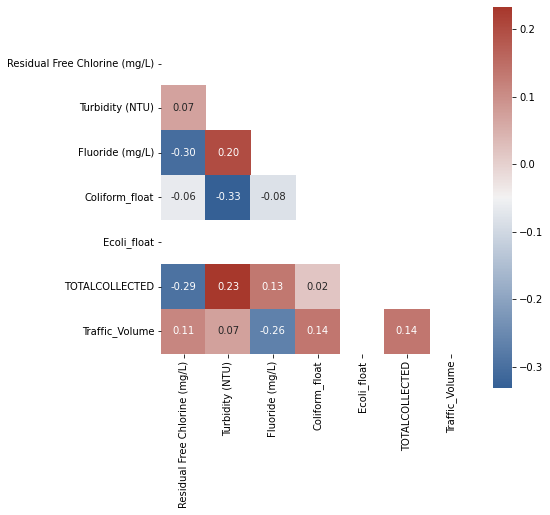

In [ ]:
cmap = sns.diverging_palette(
    250, 
    15, 
    s=75, 
    l=40, 
    n=9, 
    center='light', 
    as_cmap=True
)

matrix = df_merged_scaled.corr(method='pearson')

# Create a mask
mask = np.triu(np.ones_like(matrix, dtype=bool))

fig, ax = plt.subplots(figsize=(7, 7))
sns.heatmap(matrix, mask=mask, cmap=cmap, square=True, annot=True, fmt=".2f", ax=ax)
plt.show();

**Finding**:

We wanted to create a cool machine learning model to be able to say whether traffic and recycling had an impact on the water quality in New York City. From the correlation plot above, we can conclude that we see no significant correlation between the features. However, let's try to break it down per borough and see whether we find anything else useful in our analysis:

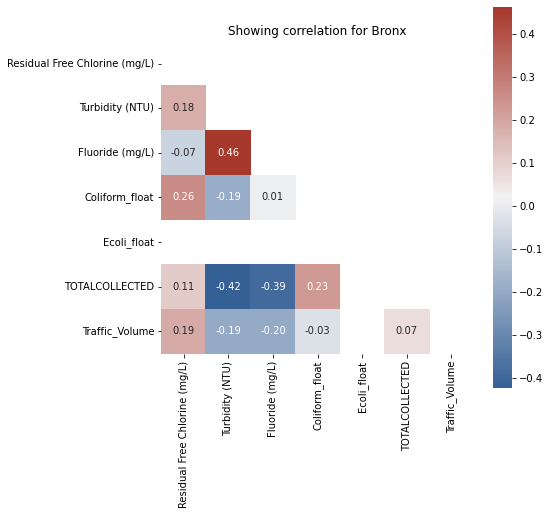

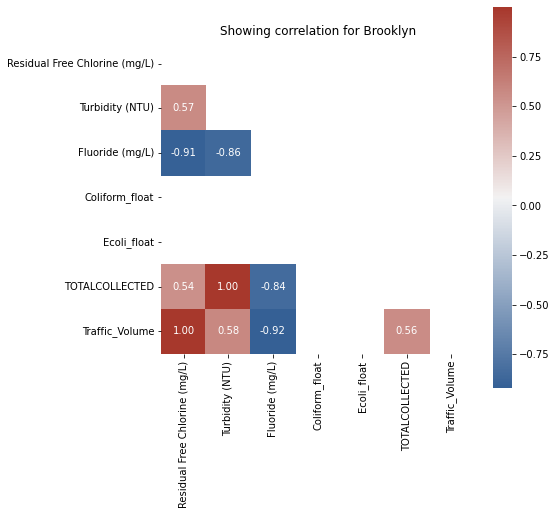

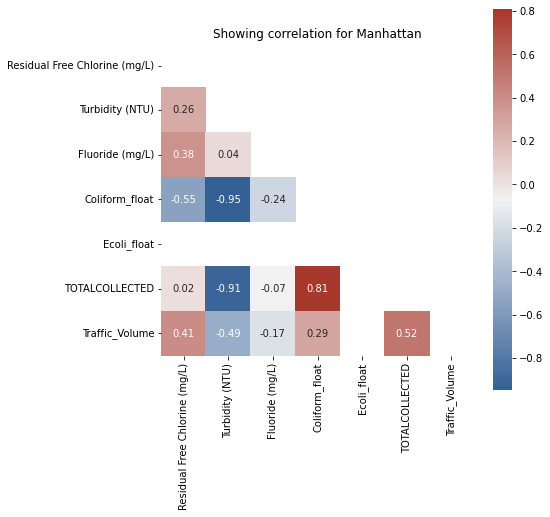

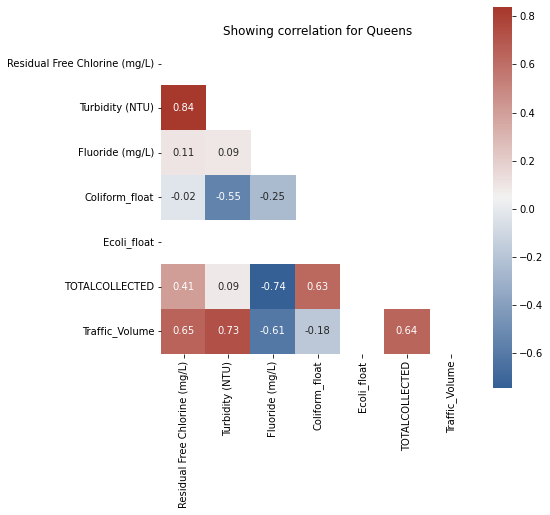

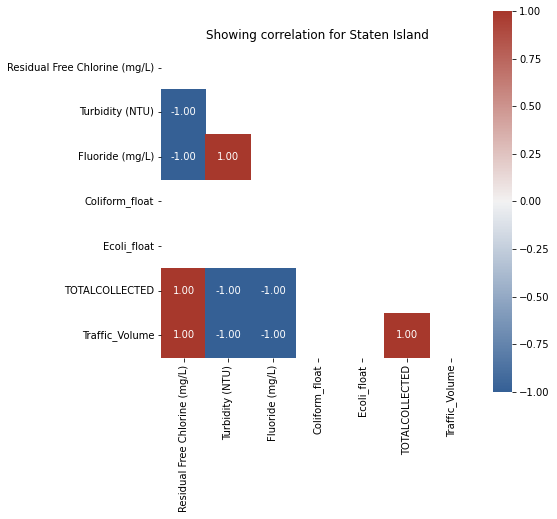

In [ ]:
boroughs = sorted(df_merged.borough.unique().tolist())
for borough in boroughs:
    cmap = sns.diverging_palette(
        250, 
        15, 
        s=75, 
        l=40, 
        n=9, 
        center='light', 
        as_cmap=True
    )

    matrix = df_merged_scaled[df_merged_scaled.borough == borough].corr(method='pearson')

    # Create a mask
    mask = np.triu(np.ones_like(matrix, dtype=bool))

    fig, ax = plt.subplots(figsize=(7, 7))
    sns.heatmap(matrix, mask=mask, cmap=cmap, square=True, annot=True, fmt=".2f", ax=ax)
    plt.title(f'Showing correlation for {borough}')
    plt.show();

In [ ]:
for borough in boroughs:
    print(f'{borough} has size {df_merged_scaled[df_merged_scaled.borough == borough].shape}')

Bronx has size (19, 10)
Brooklyn has size (3, 10)
Manhattan has size (5, 10)
Queens has size (4, 10)
Staten Island has size (2, 10)


**Findings**:

When we break down the correlation for each borough, we do see some interesting correlation between the recycling data, the traffic data and the water quality. This is basically what we wanted to show and thus what we wanted conduct a thorough analysis of, however, because of the limitations due to lack of data (which the cell above clearly show), we cannot say for sure that there in fact is a correlation between the features shown.

Due to limited resources (data-wise and time-wise), we were not able to find a dataset (or multiple datasets) that held enough data for us to conclude on an analysis like the above. However, research have shown that traffic and the amount of waste can have an impact of the water quality of certain neighbouthoods / boroughs.

<a id='website'></a>
### 5 Bringing it all together

<a id='genrea'></a>
#### 5.1 Genre

The aim of the story telling was to find a good balance between an author-driven and a reader-driven story so that we could convey our message clearly and understandably but also allow the reader to get into more details and find some additional facts and details to discover. That is why our style is mostly orientated at the drill-down story. 

From the generes is a mixture between slide show style with explanations and visualizations for each main question that we pose and animations to show the time development of the water quality, traffic and recycling most efficiently.

From the Visual Narrative these main tools were used
1. Consistent visual platform - A consistent visual platform was created to show the reader that the different presented topics (water, traffic and recycling) are connected and to ease the reading process.
2. Progress Bar - A progress bar at the top of the platform indicates how far the reader has progressed through the four different parts of our story giving an indicator where the reader is at and what is still to come.
3. 

From the Narrative Structure these main tools were used
1. User Directed Path - To guide the reader clearly trough the story a user directed path was chosen with exploration possibilities on the way. 

2. Hover Highlighting - A lot of the visualiazations reveal more information when hovering over the areas and that aims to maximize the exploratioon possibilities within the user directed path.

3. Various messaging tools were used such as headlines, introdcutions and summaries to convey a consistent and structured story. The aim was to tell an interesting story without writing blocks of texts but rather short informative facts about the data and the visualization.

<a id='visa'></a>
#### 5.2 Visualization
The main goal was to fit the visualizations to the story and show the reader the interesting part of the data. The main story line that we achieved to convey is 
- How is the drinking water quality in NYC and what are interesting patterns?
- How is the recycling in NYC and what are interesting patterns?
- How is the traffic volume in NYC and what are interesting pattern?
- And finally how are traffic and recycling influencing the water quality in NYC?

For the water quality the following visualizations were chosen.
1. Video about the water sample stations \
Goal: Support audience understanding of the sampling of water quality in NYC in an easy way

2. Folium map of the locations of the different sample stations in NYC \
Goal: Give the audience an overview of the many samples stations and explore the closest sample station (if they live in New York) for a personal connection and awareness for the topic

3. Bokeh plot of sample collection for different time frames with Hovertools \
Goal: Showing strengths and weaknesses of the water sample collection with the possibility to explore findings for different timeframes by hovering over the graphs

4. Plotly animation for the development of drinking water quality at the different locations \
Goal: Illustrate the water quality in an engaging way and through more than just a static plot. Using an animation might engage more users and keep the readers attention.

5. Plotly bar chart to point out the development of drinking water over the months of the year with a repeating pattern\
Goal: Zoom in the interesting pattern of the yearly development to explain findings in more detail to the audience.

6. Bokeh plot on how the different factors influence the overall water quality \
Goal: Pinpoint the cause of the overall insufficient water quality. Until now, the overall water quality was used to make it easier for the reader without going too much into details about water quality measures. However, now we want tos et the reader on a hunt for the reasons of the insufficient water quality to get to the root cause. 

7. Matplotlib bar charts of the influence of Turbidity, the overall yearly development and the adapted water quality measure \
Goal: The last plots were not interactive as the reader was supposed to be concentrated and focused on the results of the water quality analysis and the main point from the graphs. That is why simple plots were chosen to finish of the story with a clear takeaway.

For the recycling part the following visualizations were chosen.  
1. Plotly cumulative bar for collection type and amount distribution by borough  
Goal: Understand the overall trash and disposal type collection achivements/sanity performance of 5 NYC boroughs

2. Plotly bar for overall collection distribution by NYC community districts  
Goal: Narrow scale to districts, to understand the collection amount differences between the 59 NYC community districts

3. Bokeh line chart for collection amount time change by boroughs with tabs  
Goal: To view the time series pattern behind collection tonnages trend of different categories and compare between 5 boroughs. If we plot in one chart, the chart will be too crowded to see between each other, so Bokeh tabs is helpful.

4. Plotly map and Folium map for borough and community districts  
Goal: To present geo-information and date with feature of interest(collection amount, recycling bins, water quality etc.) together and easy for viewers to interact

5. Matplotlib bar charts of the number of recycling bins in 5 boroughs  
Goal: As a supplement point to recycling data and see if the trash collection amount correlate the number of bins.

For the traffic the following visualizations were chosen.
1. Plotly bar chart traffic volume of all 5 NYC boroughs\
Goal: Introduction to the topic and highlighting the boroughs with the most and least traffic

2. Plotly stacked bar chart for traffic development over the day\
Goal: Illustrating the typical traffic development over the day and involving difference between the boroughs to support the highlighted main trafficed boroughs

3. Plotly bar chart for traffic development over the years\
Goal: Highlighting weaknesses of the data and data collection method as traffic is observed and collected by people. 

4. Bokeh scatter plot for traffic volumes per date for the five districts\
Goal: Enabling the reader to explore the highlighted weaknesses in further detail 

5. Folium Heatmap of Traffic Volume between the 5 NYC boroughs (per date)\
Goal: Engaging the reader with an animated time development of the traffic volume


The visualizations are right for the story we aim to tell as support us in conveying our story to the reader while still making it engaging and eploratory to keep the audiences attention and they support the main points of the story telling throughout.


<a id='discussion'></a>
#### 5.3 Discussion

Understanding the separate datasets and conveying an interesting story about them to the reader went well. The data and our gained knowledge from the course enabled us to create clear and interactive visualizations to support our story effectively.

However, combining the data for a joint story could be improved. Unfortunately, there was no relationship found between the investigated topics so that no for example prediction of water quality based on traffic and recycling could be created. There are further possible influences on water quality that could be studied such as weather however the timeframe of the project did not allow to investigate these. 

<a id='contributions'></a>
### 6 Contribution table
| Contribution | Name |
|----------|:--------:|
| Part 2, 4, 5 | Bufan Deng  |
| Part 3, 4, 5 | Christian de Freiesleben Røssel |
| Part 0, 1, 5 | Lisa Halasa |